In [1]:
from functions import *

The goal of this notebook is to analyze the difference between air temperature via satellital images and in-situ measuring devices

In [2]:
import numpy as np
import rasterio
import matplotlib.pyplot as plt
import os
import rasterio
import glob
from skimage.transform import resize
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
import pandas as pd
import geopandas as gpd
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import pyproj
from geopandas.tools import sjoin
from shapely.geometry import Point
import requests
from scipy.stats import ks_2samp
from sklearn.preprocessing import OneHotEncoder
import time
from datetime import datetime
from collections import Counter

## Visualization of clean images

Load data returning metadata

In [3]:
def load_data(dir_paths, W=None, rgb=[], show=None):
    data = {}
    time_slots = []
    metas_l = []
    for i, path in enumerate(dir_paths):
        image_files = os.listdir(path)

        # Filter out files without a valid date in the filename
        valid_image_files = [img for img in image_files if extract_year_month_from_filename(img) is not None]

        # Sort the valid image files by year and month extracted from the filename
        valid_image_files = sorted(valid_image_files, key=lambda x: extract_year_month_from_filename(x))
        
        times = []
        imgs_data = []
        metas = []
        for img_file in valid_image_files:
            imagen_path = os.path.join(path, img_file)
            try:
                img_data, meta = load_raster(imagen_path, rgb[i])  # Load raster data
    
                if W:  # Resize the image if W is provided
                    img_data = resize_image(img_data, W, W)
    
                imgs_data.append(img_data)
                times.append(extract_year_month_from_filename(img_file))
                metas.append(meta)
            except:
                pass
            
        data[path] = np.array(imgs_data)
        time_slots.append(times)
        metas_l.append(metas)

    return data, time_slots,metas_l

In [4]:
# Set variables
source_folder = '../data/external/raster_masks'
rivers = {}
source_path = '../data/preprocessed/'
data_paths = ['lst','wt_interpolated','ndvi','slope', 'discharge','altitude']#,'wt','ndvi','slope', 'discharge','masked']#,'slope', 'discharge']#, 'ndvi', 'wt', 'masked','discharge', 'slope']#, 'wt_interpolated']
dir_paths = [os.path.join(source_path,p) for p in data_paths]
all_dir_paths = {k:[] for k in data_paths}    
total_data = {}
total_times = {}
complete_rivers = []
filter_river = None
W=256
time_split = True
total_metas = {}

# Load rivers
for subdir, dirs, files in os.walk(source_folder):
    for i,file in enumerate(files):
        r,m = load_raster(os.path.join(subdir, file), False)
        name = file.split('.')[0].split('bw_')[-1]
        rivers[name] = r

# Load input paths
for i,dir_p in enumerate(dir_paths):
    if data_paths[i] != 'discharge' and data_paths[i] != 'slope' and data_paths[i] != 'altitude':
        imgs_per_river = Counter()
    for subdir, dirs,files in os.walk(dir_p):
        if subdir != dir_p and not subdir.endswith('masked') and not subdir.endswith('.ipynb_checkpoints'): 
            all_dir_paths[data_paths[i]].append(subdir)
        elif subdir.endswith('masked') and 'masked' in data_paths:
            all_dir_paths['masked'].append(subdir)
        elif dir_p.endswith('altitude'):
            all_dir_paths[data_paths[i]].extend(files)

# Load input data

for k,v in all_dir_paths.items():
    if filter_river != None:
        v = [v[i] for i in filter_river]
    
    if k != 'discharge' and k != 'slope' and k != 'altitude':
        if k == 'lst' or k == 'masked':
            list_rgb = [True]*len(v)
        else:
            list_rgb = [False]*len(v)
            
        data, times, metas = load_data(v,W,list_rgb)
        if k!='masked':
            labels = []
            for ki,value in data.items():
                labels+=[ki.split('/')[-1]]*len(value)
        
        data_values = [np.array(img) for sublist in list(data.values()) for img in sublist]
        times_list = [t for sublist in times for t in sublist]
        
        metas_list = [m for sublist in metas for m in sublist]
        
   
        if time_split:
            dates = [datetime.strptime(date, '%Y-%m') for date in times_list]
            pairs = sorted(zip(dates, data_values, labels, metas_list), key=lambda x: x[0])
            sorted_dates, data_values, labels, metas = zip(*pairs)
            times_list = [date.strftime('%Y-%m') for date in sorted_dates]
            
        total_data[k] = np.array(data_values)
        total_times[k] = times_list
        total_metas[k] = metas
        print(k,':' ,total_data[k].shape)
        


# Hot encoding
encoder = OneHotEncoder(sparse_output=False)
river_encoded = encoder.fit_transform(np.array(labels).reshape(-1, 1))
data_targets = total_data['wt_interpolated']
results = {'MAE':0,'MSE':0,'RMSE':0,'R²':0,'MAPE (%)':0,'MSE sample-wise':0}

lst : (147, 256, 256, 3)
wt_interpolated : (147, 256, 256)
ndvi : (147, 256, 256)


In [5]:
for k,v in all_dir_paths.items():
    total = []
    metas = []
    if k == 'discharge' or k == 'slope' or k == 'altitude':
        imgss = {}
        for i,lab in enumerate(labels):
            for file in v:
                if lab == file.split('/')[-1] or lab == file.split('.')[0]:
                    if lab not in imgss:
                        if k != 'altitude':
                            file_path = os.path.join(file,os.listdir(file)[0])
                        else:
                            file_path = os.path.join('../data/preprocessed/altitude', file)
                        print(file_path)
                        r,m = load_raster(file_path, False)
                        var = resize_image(r, W,W)
                        imgss[lab] = var
                    else:
                        var = imgss[lab]
                           
                    total.append(var)
                    metas.append(m)
                        
        total_data[k] = np.array(total)
        total_metas[k] = metas
        print(k, np.array(total).shape)

../data/preprocessed/slope/cell_72/discharge_cell_72.tif
../data/preprocessed/slope/cell_212/discharge_cell_212.tif
../data/preprocessed/slope/cell_93/discharge_cell_93.tif
../data/preprocessed/slope/cell_146/discharge_cell_146.tif
../data/preprocessed/slope/cell_23/discharge_cell_23.tif
../data/preprocessed/slope/cell_296/discharge_cell_296.tif
../data/preprocessed/slope/cell_180/discharge_cell_180.tif
../data/preprocessed/slope/cell_197/discharge_cell_197.tif
../data/preprocessed/slope/cell_27/discharge_cell_27.tif
../data/preprocessed/slope/cell_279/discharge_cell_279.tif
../data/preprocessed/slope/cell_354/discharge_cell_354.tif
../data/preprocessed/slope/cell_163/discharge_cell_163.tif
../data/preprocessed/slope/cell_176/discharge_cell_176.tif
slope (147, 256, 256)
../data/preprocessed/discharge/cell_72/discharge_cell_72.tif
../data/preprocessed/discharge/cell_212/discharge_cell_212.tif
../data/preprocessed/discharge/cell_93/discharge_cell_93.tif
../data/preprocessed/discharge/cel

#### Load rivers

In [6]:
rivers = {}
included_files = []
output_directory = '../data/external/shp/clipped_rivers_grid_cells_ogr'
a=0

for i,riv in enumerate(os.listdir(output_directory)):
    # Check if the file is a shapefile
    try:
        if riv.endswith('.shp'):
            a+=1
            print(f"Processing file: {riv}")
            river = gpd.read_file(os.path.join(output_directory, riv))
            #combined_river = unary_union(river.geometry)
            
            total_length = river.length.sum()  # Longitud total en metros

            # Calcular el área del bounding box de la geometría combinada
            bounding_box = river.total_bounds  # [minx, miny, maxx, maxy]
            width = bounding_box[2] - bounding_box[0]
            height = bounding_box[3] - bounding_box[1]
            area = width * height  # Área en metros 

            bounding_box_diagonal = ((bounding_box[2] - bounding_box[0])**2 + (bounding_box[3] - bounding_box[1])**2)**0.5

            length_percentage = (total_length / bounding_box_diagonal) * 100  # Comparación en función de la diagonal
            
            # Definir umbrales
            min_area_threshold = 225_000#100000000  # Área mínima en m² (0.225 km²)100_000_000
            min_length_threshold = 300# 3000  # Longitud mínima en metros

            # Plot the GeoDataFrame
            river = river.to_crs("EPSG:4326")
           
            if area >= min_area_threshold and total_length > min_length_threshold and length_percentage > 50:                
                river = river.to_crs("EPSG:4326")
                rivers[f'cell_{i}'] = river
                included_files.append(riv)
                print('Added', f'cell_{i}')

    except Exception as e:
        print(f"Error processing file: {riv}",e)
        pass
        

Processing file: rivers_grid_cell_666.shp
Added cell_4
Processing file: rivers_grid_cell_320.shp
Added cell_10
Processing file: rivers_grid_cell_187.shp
Added cell_19
Processing file: rivers_grid_cell_754.shp
Added cell_20
Processing file: rivers_grid_cell_567.shp
Added cell_21
Processing file: rivers_grid_cell_490.shp
Added cell_23
Processing file: rivers_grid_cell_328.shp
Added cell_24
Processing file: rivers_grid_cell_597.shp
Added cell_27
Processing file: rivers_grid_cell_242.shp
Processing file: rivers_grid_cell_304.shp
Added cell_32
Processing file: rivers_grid_cell_109.shp
Added cell_52
Processing file: rivers_grid_cell_285.shp
Added cell_61
Processing file: rivers_grid_cell_405.shp
Added cell_63
Processing file: rivers_grid_cell_199.shp
Added cell_66
Processing file: rivers_grid_cell_356.shp
Added cell_67
Processing file: rivers_grid_cell_418.shp
Added cell_72
Processing file: rivers_grid_cell_303.shp
Added cell_80
Processing file: rivers_grid_cell_478.shp
Added cell_85
Process

#### Show variables and check bounds

image_2015-01.tiff
../data/preprocessed/lst/cell_163
../data/raw/ndvi/cell_163/2015-01_ndvi.tif


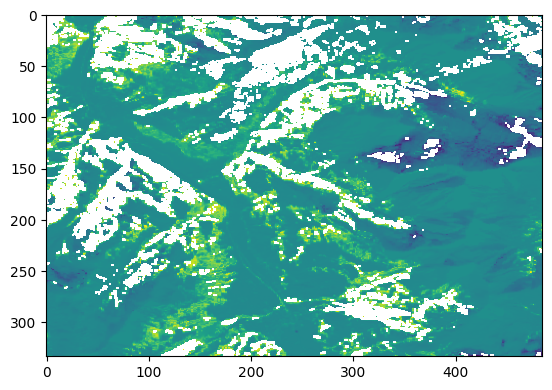

In [7]:
img1=os.listdir(all_dir_paths['lst'][0])[0]
print(img1)
print(all_dir_paths['lst'][0])
img1 = '../data/raw/ndvi/cell_163/2015-01_ndvi.tif'
print(img1)
#r, m = load_raster(os.path.join(all_dir_paths['lst'][0],img1))
r,m  = load_raster(img1, False)
plt.imshow(r)

image_2015-01.tiff
../data/preprocessed/lst/cell_163
BoundingBox(left=7.771354238458147, bottom=46.80740134402593, right=7.903103662033836, top=46.89779914165599)


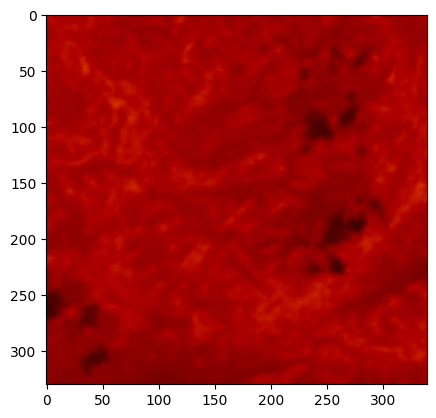

In [8]:
img1=os.listdir(all_dir_paths['lst'][0])[0]
print(img1)
print(all_dir_paths['lst'][0])
r, m = load_raster(os.path.join(all_dir_paths['lst'][0],img1))
plt.imshow(r)
print(m.bounds)

In [9]:
m.bounds
BoundingBox(left=7.771354238458147, bottom=46.80740134402593, right=7.903103662033836, top=46.89779914165599)

NameError: name 'BoundingBox' is not defined

In [10]:
rivers['cell_163'].total_bounds

array([ 7.37861742, 46.44849846,  7.5089537 , 46.5384689 ])

In [62]:
are_equal = np.allclose(rivers['cell_163'].total_bounds, np.array(m.bounds), atol=1e-3)
are_equal

True

<Axes: >

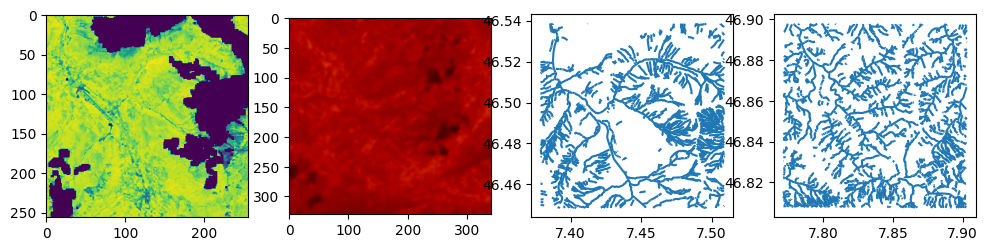

In [48]:
fig, axs = plt.subplots(1,4,figsize=(12, 6))
axs[0].imshow(image3_data)
axs[1].imshow(r)
image2.plot(ax=axs[2])
rivers['cell_745'].plot(ax=axs[3])

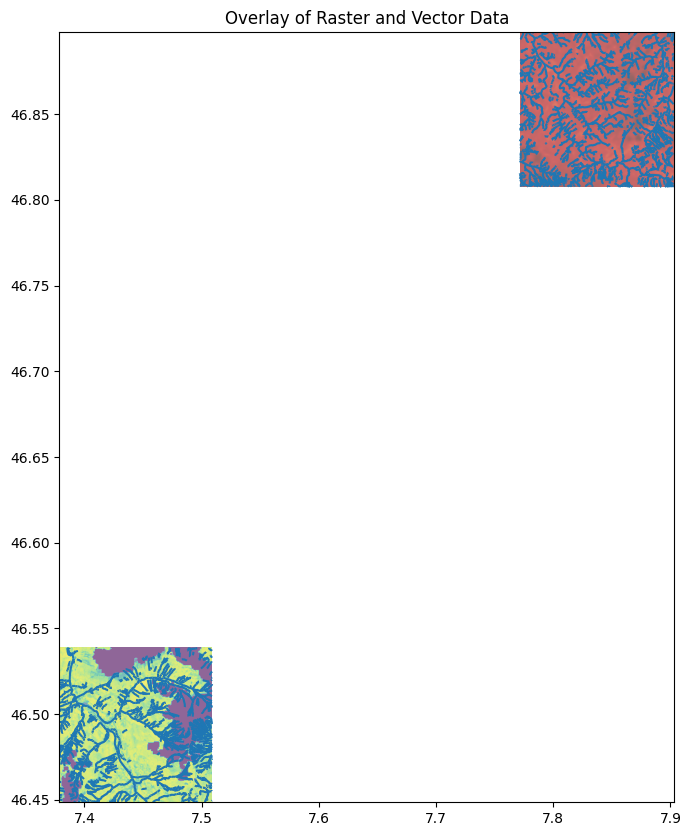

In [49]:
image1_data = r
image2 = rivers['cell_163']
src1 = m
image1_extent = m.bounds

image3_data,src3 = load_raster(os.path.join(all_dir_paths['ndvi'][0],os.listdir(all_dir_paths['ndvi'][0])[0]),False)
image3_extent = src3.bounds
# Plot the two images with their extents
fig, ax = plt.subplots(figsize=(10, 10))

# Display the raster image
ax.imshow(
    image1_data, 
    extent=[image1_extent.left, image1_extent.right, image1_extent.bottom, image1_extent.top], 
    cmap='viridis', 
    alpha=0.6
)

ax.imshow(
    image3_data, 
    extent=[image3_extent.left, image3_extent.right, image3_extent.bottom, image3_extent.top], 
    cmap='viridis', 
    alpha=0.6
)
ax.set_title('Overlay of Raster and Vector Data')

# Plot the GeoDataFrame on top of the raster
image2.plot(ax=ax)# color='none', edgecolor='black', linewidth=1)  # Adjust style as needed
rivers['cell_745'].plot(ax=ax)

# Show plot
plt.show()

In [47]:
for k,riv in rivers.items():
    if np.allclose(riv.total_bounds, np.array(m.bounds), atol=1e-4):
        print(k)

cell_745


<Axes: >

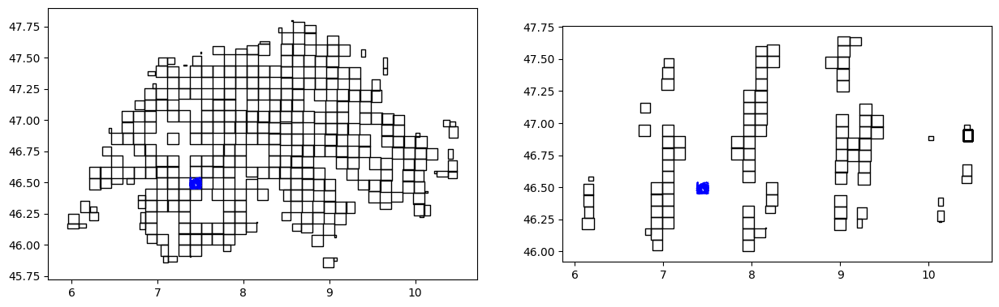

In [122]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Rectangle
from shapely.geometry import box

source_dir='../data/raw/ndvi'
# Example list of images (replace this with your actual images)
# For demonstration, let's create random images
bounding_boxes = []
cells1=[]
for subdir, dirs, files in os.walk(source_dir):
    if subdir != source_dir and os.listdir(subdir)!=[]:
        file = os.listdir(subdir)[0]
        if file.endswith('tif'):
            r,m = load_raster(os.path.join(subdir,file),False)
            bounds = m.bounds
            bounding_boxes.append(box(*bounds))
            cells1.append(subdir.split('/')[-1])

fig,ax= plt.subplots(1,2,figsize=(15,10))
gdf =  gpd.GeoDataFrame(geometry=bounding_boxes, crs="EPSG:3426")             
# Add labels and 
gdf.plot(ax=ax[0],color='none')
riv.plot(ax=ax[0],edgecolor='blue')

source_dir='../data/raw/lst'
bounding_boxes2 = []
cells2=[]
for subdir, dirs, files in os.walk(source_dir):
    if subdir != source_dir and os.listdir(subdir)!=[]:
        file = os.listdir(subdir)[0]
        if file.endswith('tiff'):
            r,m = load_raster(os.path.join(subdir,file))
            bounds = m.bounds
            bounding_boxes2.append(box(*bounds))
            cells2.append(subdir.split('/')[-1])

gdf =  gpd.GeoDataFrame(geometry=bounding_boxes2, crs="EPSG:3426")             
# Add labels and 
gdf.plot(ax=ax[1],color='none')
riv.plot(ax=ax[1],edgecolor='blue')

Intersecting: cell_489 cell_245
Intersecting: cell_482 cell_1
Intersecting: cell_985 cell_27
Intersecting: cell_1211 cell_23
Intersecting: cell_684 cell_322
Intersecting: cell_241 cell_145
Intersecting: cell_1168 cell_203
Intersecting: cell_456 cell_212
Intersecting: cell_1258 cell_105
Intersecting: cell_21 cell_197
Intersecting: cell_785 cell_400
Intersecting: cell_824 cell_73
Intersecting: cell_349 cell_397
Intersecting: cell_1186 cell_367
Intersecting: cell_791 cell_96
Intersecting: cell_908 cell_295
Intersecting: cell_652 cell_120
Intersecting: cell_530 cell_282
Intersecting: cell_584 cell_180
Intersecting: cell_227 cell_177
Intersecting: cell_778 cell_97
Intersecting: cell_1288 cell_231
Intersecting: cell_1090 cell_328
Intersecting: cell_745 cell_163
Intersecting: cell_191 cell_201
Intersecting: cell_1040 cell_55
Intersecting: cell_618 cell_131
Intersecting: cell_1196 cell_366
Intersecting: cell_418 cell_247
Intersecting: cell_580 cell_244
Intersecting: cell_516 cell_146
Intersect

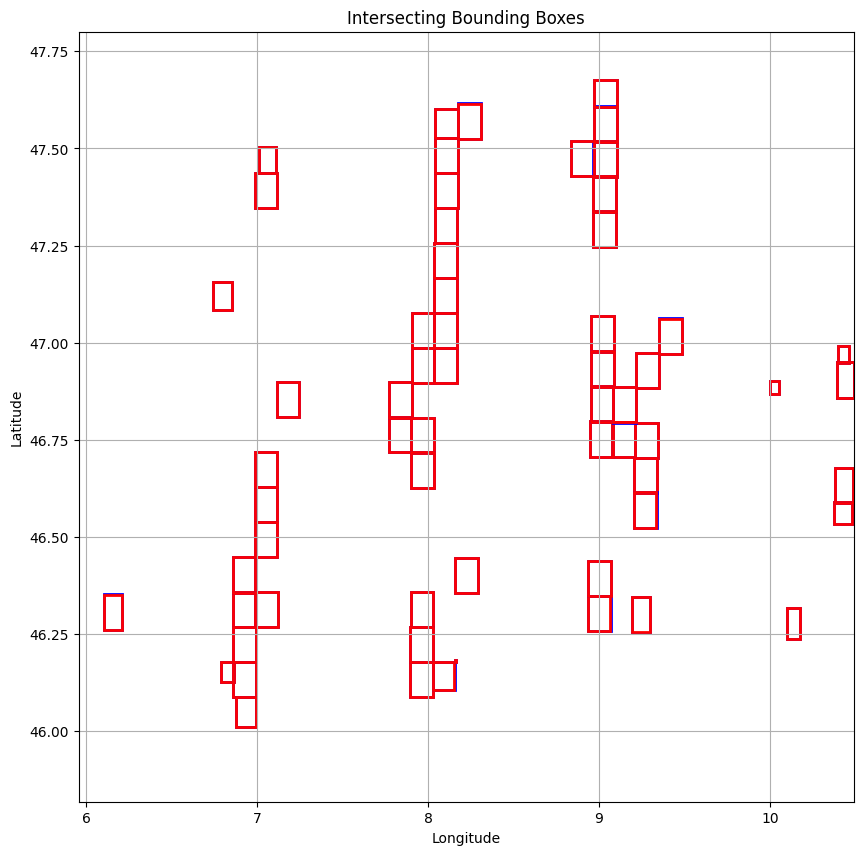

In [123]:
from shapely.geometry import Polygon
from matplotlib.patches import Polygon as mplPolygon

fig, ax = plt.subplots(figsize=(10, 10))
list1=bounding_boxes
list2=bounding_boxes2
# Iterate through each bounding box in list1
# Iterate through each polygon in list1
for i,poly1 in enumerate(list1):
    # Check for intersections with each polygon in list2
    for j,poly2 in enumerate(list2):
        #if poly1.intersects(poly2):
        if np.allclose(np.array(poly1.bounds), np.array(poly2.bounds), atol=1e-3):
        #if poly1.bounds == poly2.bounds:
            # Plot poly1
            print("Intersecting:", cells1[i], cells2[j]) 
            
            mpl_poly1 = mplPolygon(list(poly1.exterior.coords), edgecolor='blue', facecolor='none', linewidth=2)
            ax.add_patch(mpl_poly1)

            # Plot poly2
            mpl_poly2 = mplPolygon(list(poly2.exterior.coords), edgecolor='red', facecolor='none', linewidth=2)
            ax.add_patch(mpl_poly2)

# Set plot limits based on all polygons
all_polys = list1 + list2
all_x = [point[0] for poly in all_polys for point in poly.exterior.coords]
all_y = [point[1] for poly in all_polys for point in poly.exterior.coords]
ax.set_xlim(min(all_x), max(all_x))
ax.set_ylim(min(all_y), max(all_y))

# Customize plot
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")
ax.set_title("Intersecting Bounding Boxes")
plt.grid(visible=True)
plt.show()

In [90]:

riv = rivers['cell_163']
print(riv.total_bounds)
for subdir, dirs, files in os.walk(source_dir):
    if subdir != source_dir and os.listdir(subdir)!=[]:
        file = os.listdir(subdir)[0]
        if file.endswith('tiff'):
            r,m = load_raster(os.path.join(subdir,file))
            #print('Checking',subdir, file)
            print(m.bounds)
            #fig, ax = plt.subplots(figsize=(10, 10))

            '''ax.imshow(
                r, 
                extent=[m.bounds.left, m.bounds.right, m.bounds.bottom, m.bounds.top], 
                cmap='viridis', 
                alpha=0.6
            )'''
            #ax.set_title('Overlay of Raster and Vector Data')
            
            # Plot the GeoDataFrame on top of the raster
            #riv.plot(ax=ax)# color='none', edgecolor='black', linewidth=1)  # Adjust style as needed
            
            # Show plot
            #plt.show()
            if np.allclose(riv.total_bounds, np.array(m.bounds), atol=1e-3):
                print('Found it', subdir, file)
                print(m.bounds)
            print()
        

[ 7.37861742 46.44849846  7.5089537  46.5384689 ]
BoundingBox(left=9.081253776078176, bottom=46.79470141343241, right=9.215091921411961, top=46.886467402962836)

BoundingBox(left=6.989359589198292, bottom=46.267930241250156, right=7.119435849753807, top=46.35808893498393)

BoundingBox(left=7.771354238458147, bottom=46.80740134402593, right=7.903103662033836, top=46.89779914165599)

BoundingBox(left=9.346450743233985, bottom=46.8802082676286, right=9.480760006061473, top=46.97229494354414)

BoundingBox(left=8.970727103746942, bottom=47.51609276506481, right=9.105423150743922, top=47.607583481534746)

BoundingBox(left=10.001946812572134, bottom=46.86864474189131, right=10.051931992354579, top=46.900871686179535)

BoundingBox(left=6.861030242046077, bottom=46.08749243081969, right=6.991178539338154, top=46.17774651731851)

BoundingBox(left=9.19464202514946, bottom=46.25415774877375, right=9.297271761484067, top=46.34475471025401)

BoundingBox(left=7.770774707235973, bottom=46.717455302428

In [138]:
from pyproj import Transformer

def equal_coordenates(crs_2056, crs_wgs84, bounds_2056, bounds_wgs84):
    transformer = Transformer.from_crs(crs_2056, crs_wgs84, always_xy=True)
    minx, miny = transformer.transform(bounds_2056.left, bounds_2056.bottom)
    maxx, maxy = transformer.transform(bounds_2056.right, bounds_2056.top)
    # Transformed bounding box in WGS84
    transformed_bounds = (minx, miny, maxx, maxy)
    
    # Original WGS84 bounds for comparison
    original_bounds_wgs84 = (bounds_wgs84.left, bounds_wgs84.bottom, bounds_wgs84.right, bounds_wgs84.top)
    
    # Set a tolerance for floating point comparisons
    tolerance = 0.001
    is_equal = all(
        abs(transformed_bounds[i] - original_bounds_wgs84[i]) < tolerance
        for i in range(4)
    )
    
    print(transformed_bounds)
    return is_equal

0 cell_72
False
[False False False False]
[ True  True  True  True]
BoundingBox(left=9.19225086105802, bottom=46.18246937388851, right=9.248610421572925, top=46.25482702815008) EPSG:4326
BoundingBox(left=8.16085933660057, bottom=46.535535956770076, right=8.292460741730267, top=46.62609235265203) EPSG:4326
[ 8.16085934 46.53553596  8.29246074 46.62609235]
(8.160729654753716, 46.53600320813806, 8.292757481751417, 46.625229360580484)
True
(8.160729646537476, 46.53600319816134, 8.29275747349723, 46.625229350613374)
True
(8.160729646537476, 46.53600319816134, 8.29275747349723, 46.625229350613374)
True
(8.161010320626389, 46.55705198519023, 8.262206056498943, 46.625454306370635)
False


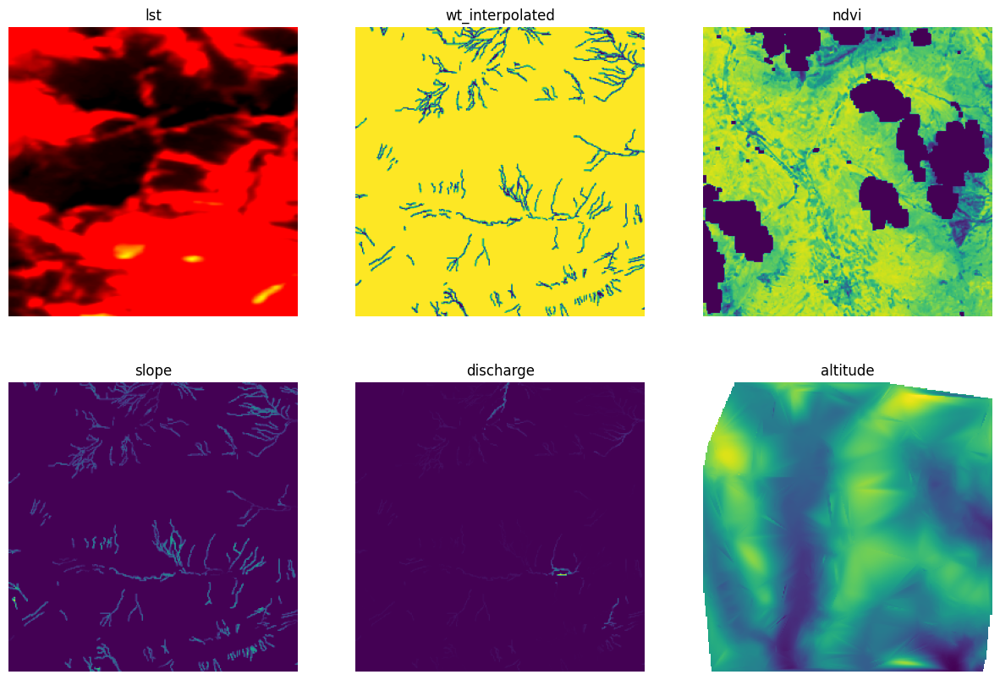

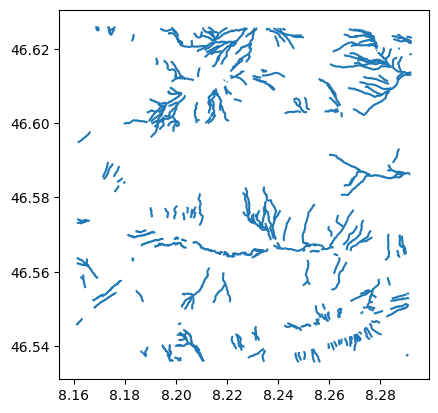


1 cell_212
False
[False False False False]
[ True  True  True  True]
BoundingBox(left=9.078501244742464, bottom=46.70489686282639, right=9.211887170029986, top=46.7965120651352) EPSG:4326
BoundingBox(left=7.509908815474274, bottom=47.257933550850716, right=7.642322791495237, top=47.34794268581439) EPSG:4326
[ 7.50990882 47.25793355  7.64232279 47.34794269]
(7.50989044878678, 47.25788592350506, 7.642613329229582, 47.34785308965253)
True
(7.509890441440276, 47.257885913088145, 7.64261332184474, 47.34785307924437)
True
(7.509890441440276, 47.257885913088145, 7.64261332184474, 47.34785307924437)
True
(7.509918173776347, 47.27893311538588, 7.611646002398484, 47.347903424258206)
False


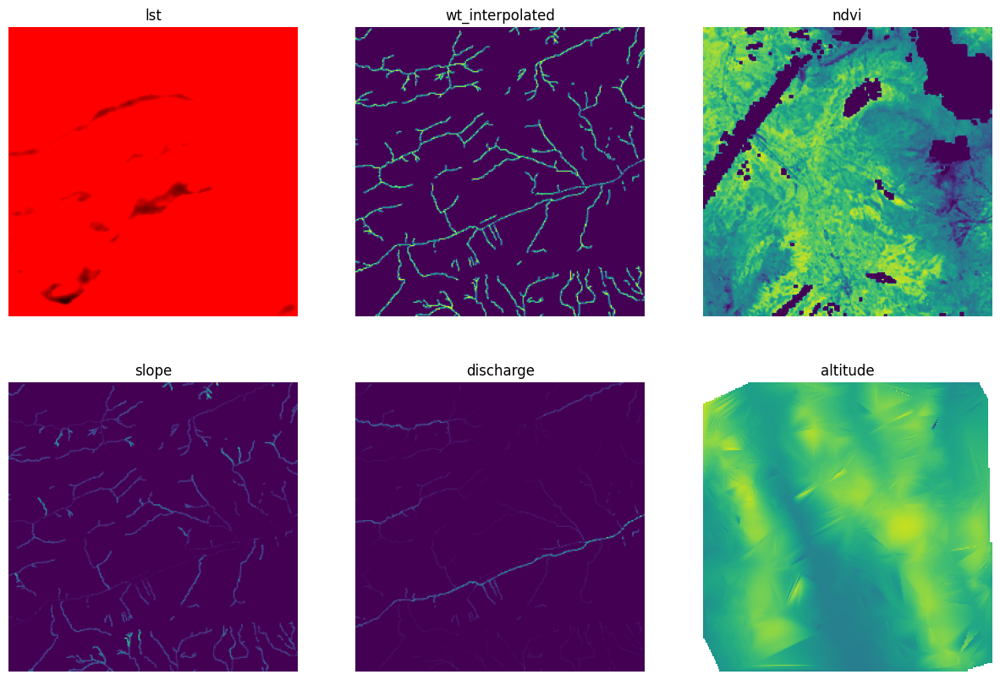

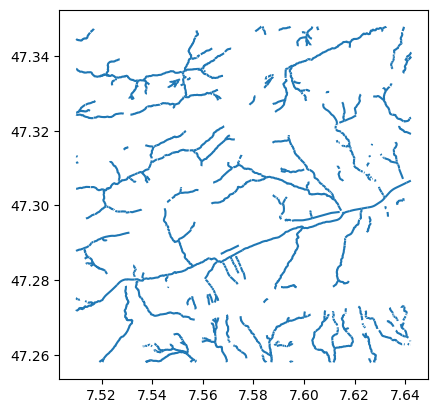


2 cell_93
False
[False False False False]
[ True  True  True  True]
BoundingBox(left=8.963009111732045, bottom=47.246430817351545, right=9.097780829431455, top=47.337767729172185) EPSG:4326
BoundingBox(left=8.291116382836329, bottom=46.53423146475049, right=8.422364300740307, top=46.62516823743136) EPSG:4326
[ 8.29111638 46.53423146  8.4223643  46.62516824]
(8.29107549675087, 46.5351010168855, 8.42331606905202, 46.62417559542189)
True
(8.291075488410607, 46.535101006941375, 8.423316060673672, 46.62417558548759)
True
(8.291075488410607, 46.535101006941375, 8.423316060673672, 46.62417558548759)
True
(8.291406884433243, 46.556149446613496, 8.392765812072984, 46.62443558999509)
False


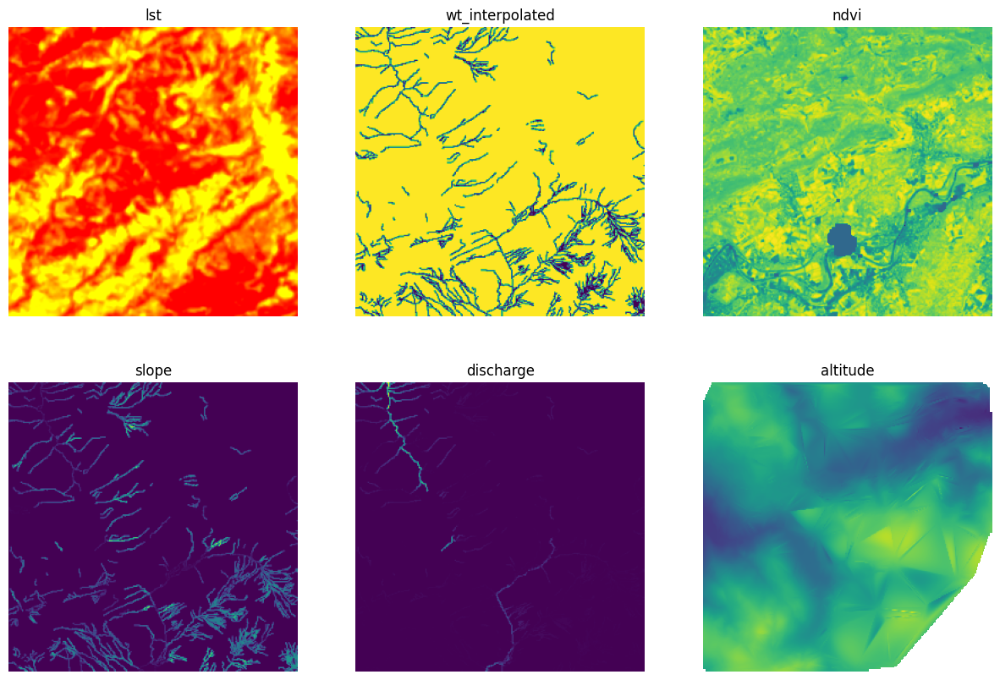

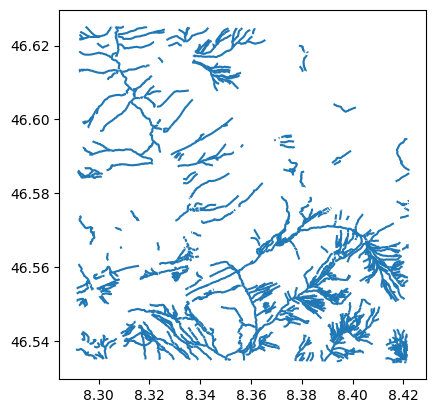


3 cell_146
False
[False False False False]
[ True  True  True  True]
BoundingBox(left=7.903135024914297, bottom=46.89676939714379, right=8.035332044668174, top=46.987298534401425) EPSG:4326
BoundingBox(left=7.9071188042767, bottom=47.34648960843279, right=8.04028308149538, top=47.43700886757992) EPSG:4326
[ 7.9071188  47.34648961  8.04028308 47.43700887]
(7.907021443274677, 47.34690481614503, 8.040635756516608, 47.43641065155988)
True
(7.907021435542498, 47.34690480578765, 8.040635748745414, 47.436410641211836)
True
(7.907021435542498, 47.34690480578765, 8.040635748745414, 47.436410641211836)
True
(7.907206132830107, 47.367951107473566, 8.009617625471655, 47.4365678229104)
False


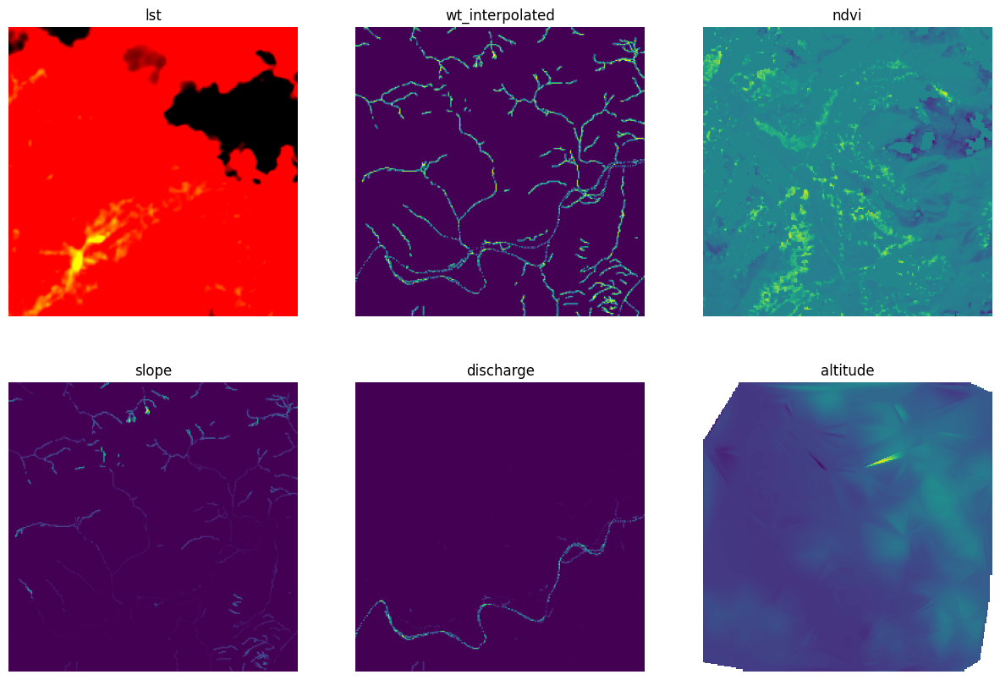

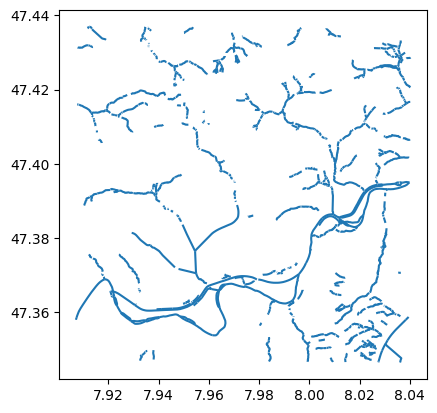


4 cell_23
False
[False False False False]
[ True  True  True  True]
BoundingBox(left=6.790801076070959, bottom=46.12693746591233, right=6.861513753408955, top=46.17715517664118) EPSG:4326
BoundingBox(left=8.552066662709509, bottom=46.53171755076026, right=8.684131036673117, top=46.62278573965165) EPSG:4326
[ 8.55206666 46.53171755  8.68413104 46.62278574]
(8.551752398185462, 46.532848031453916, 8.684416207102416, 46.62161875646534)
False
(8.551752389579152, 46.53284802158457, 8.684416198457745, 46.62161874660615)
False
(8.551752389579152, 46.53284802158457, 8.684416198457745, 46.62161874660615)
False
(8.552185209694857, 46.55389559371138, 8.653868793139683, 46.62194883993954)
False


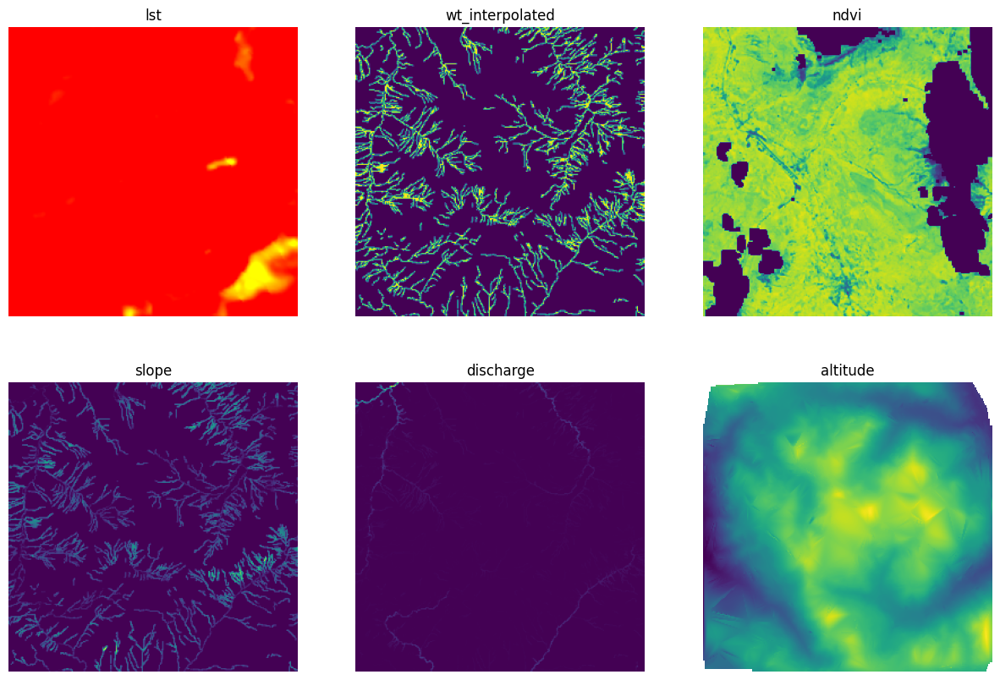

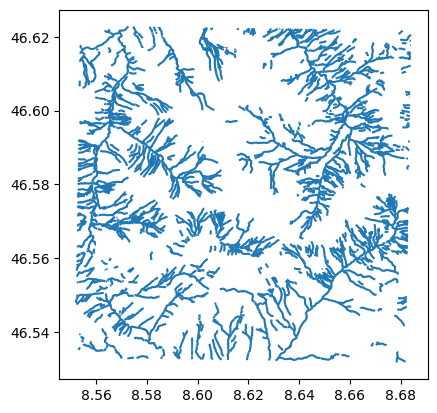

In [166]:
for i in range(5):
    print(i,labels[i] )
    riu = labels[i]
    m1=total_metas['lst'][i].bounds
    m2=total_metas['ndvi'][i].bounds
    print(m1==m2)
    print(m1==rivers[labels[i]].total_bounds)
    print(m2==rivers[labels[i]].total_bounds)
    print(m1,total_metas['lst'][i].crs)
    print(m2,total_metas['ndvi'][i].crs)
    print(rivers[labels[i]].total_bounds)

    crs_wgs84 = total_metas['lst'][i].crs
    bounds_wgs84 = m2


    bounds_2056 = total_metas['wt_interpolated'][i].bounds
    crs_2056 = total_metas['wt_interpolated'][i].crs
    print(equal_coordenates(crs_2056, crs_wgs84, bounds_2056, bounds_wgs84))
    
    bounds_2056 = total_metas['discharge'][i].bounds
    crs_2056 = total_metas['discharge'][i].crs    
    print(equal_coordenates(crs_2056, crs_wgs84, bounds_2056, bounds_wgs84))

    bounds_2056 = total_metas['slope'][i].bounds
    crs_2056 = total_metas['slope'][i].crs    
    print(equal_coordenates(crs_2056, crs_wgs84, bounds_2056, bounds_wgs84))

    bounds_2056 = total_metas['altitude'][i].bounds
    crs_2056 = total_metas['altitude'][i].crs    
    print(equal_coordenates(crs_2056, crs_wgs84, bounds_2056, bounds_wgs84))

  

    data=[]
    for k in data_paths:
        data.append(total_data[k][i])
    
    # Set up the figure and axes for a 2x3 grid
    fig, axs = plt.subplots(2, 3, figsize=(15, 10))  # Adjust figsize as needed
    
    # Loop through each subplot and display the data
    for i, ax in enumerate(axs.flat):
        if data_paths[i] =='lst':
            ax.imshow(np.clip(data[i]*(6/255),0,1), cmap='viridis')  # Replace with your plotting function
        else:
            ax.imshow(data[i], cmap='viridis')
        ax.set_title(f"{data_paths[i]}")  # Add titles to each subplot (optional)
        ax.axis("off")  # Turn off the axis for a cleaner look (optional)

    plt.show()
    
    rivers[riu].plot()  # Plot the 7th plot data
    plt.show()
    
    print()
    
    

In [153]:
os.listdir(all_dir_paths['lst'][0])

['image_2015-01.tiff',
 'image_2015-08.tiff',
 'masked',
 'image_2014-09.tiff',
 'image_2019-08.tiff',
 'image_2013-09.tiff',
 'image_2015-11.tiff',
 'image_2016-12.tiff',
 'image_2016-10.tiff']

In [160]:
r,m=load_raster('../data/raw/lst/cell_163/image_2015-01.tiff')
r,m=load_raster('../data/raw/ndvi/cell_163/2015-01_ndvi.tif', False)
r,m=load_raster('../data/preprocessed/ndvi/cell_163/ndvi_2015-01.tiff', False)


Carrego ../data/raw/lst/cell_163/image_2015-01.tiff
CRS after loading: EPSG:4326
Bounding Box after loading: BoundingBox(left=7.771354238458147, bottom=46.80740134402593, right=7.903103662033836, top=46.89779914165599)
Carrego ../data/raw/ndvi/cell_163/2015-01_ndvi.tif
CRS after loading: EPSG:4326
Bounding Box after loading: BoundingBox(left=7.378492249172514, bottom=46.44846974374081, right=7.509197123011905, top=46.538480935209584)
Carrego ../data/preprocessed/ndvi/cell_163/ndvi_2015-01.tiff
CRS after loading: EPSG:4326
Bounding Box after loading: BoundingBox(left=7.378617421905812, bottom=46.44849845558667, right=7.508953696585241, top=46.5384689028151)


1


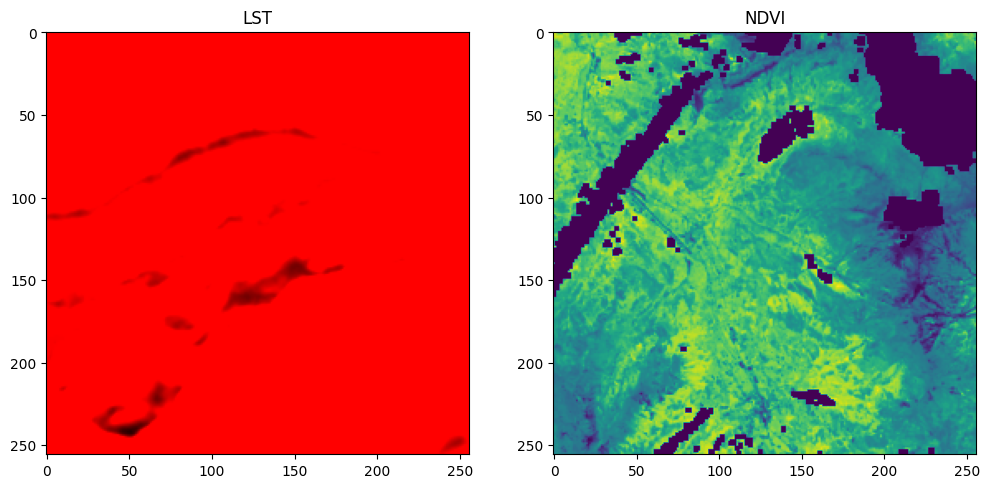

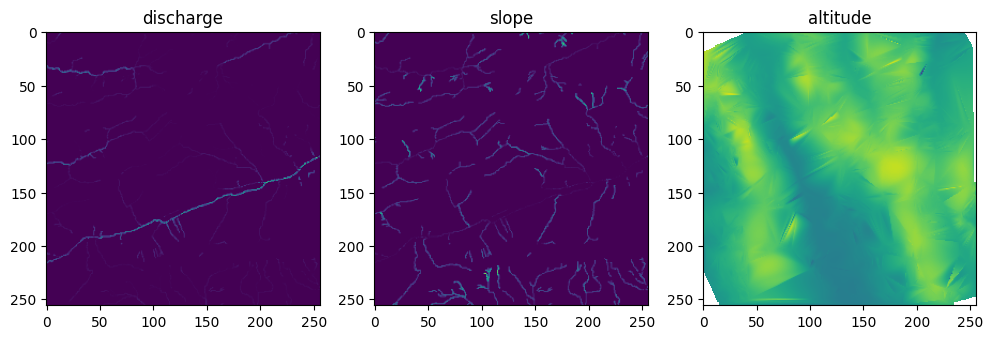

False
False
2


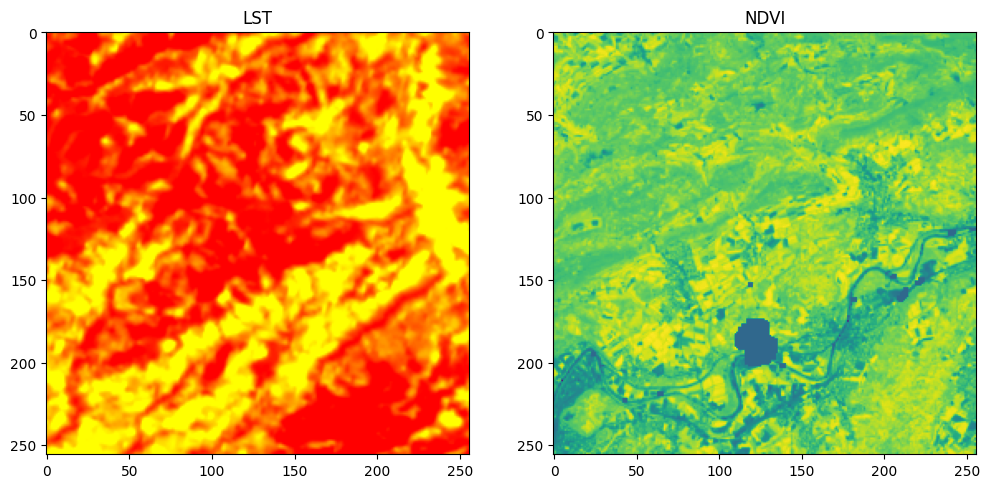

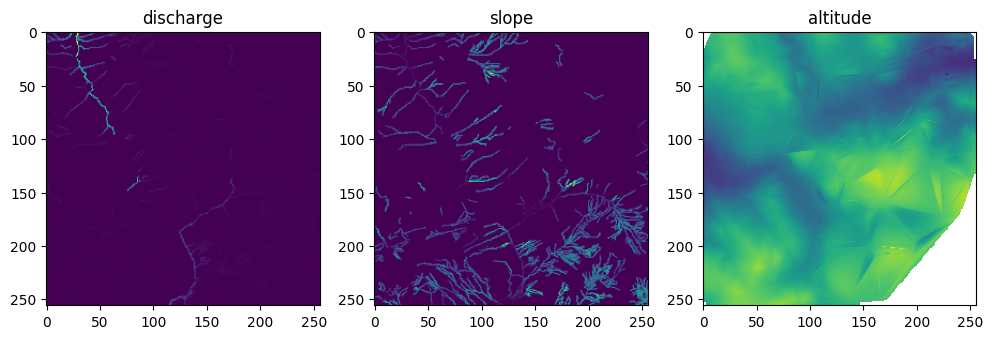

False
False
3


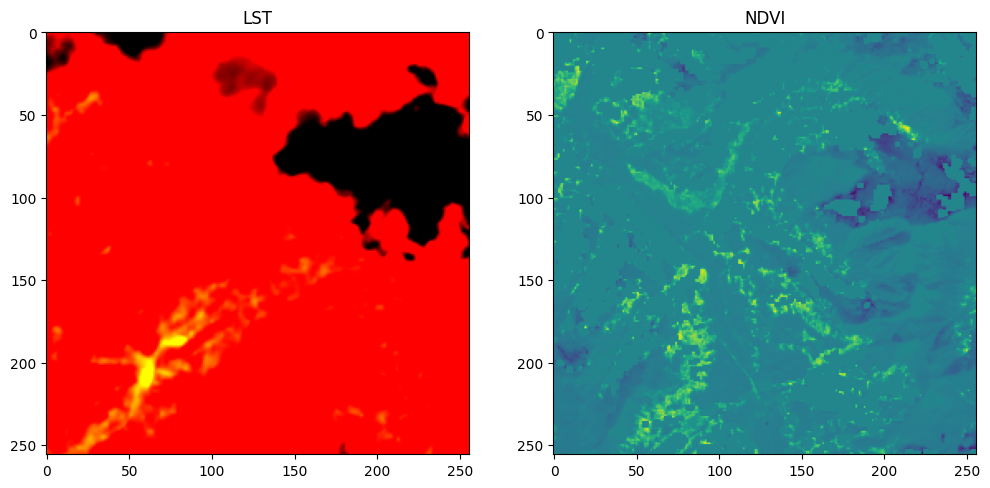

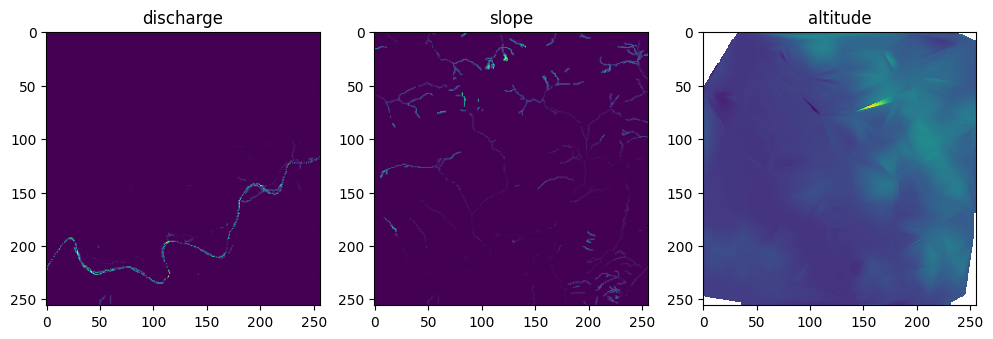

False
False
4


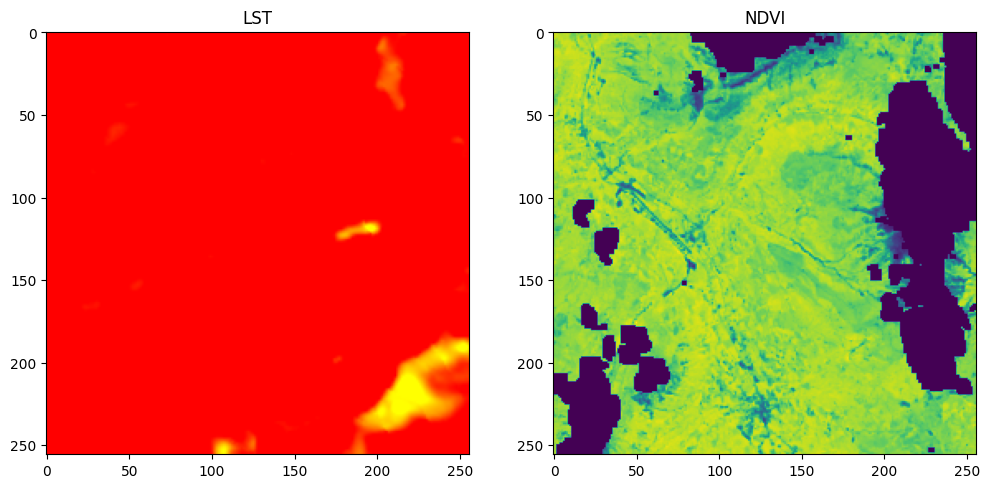

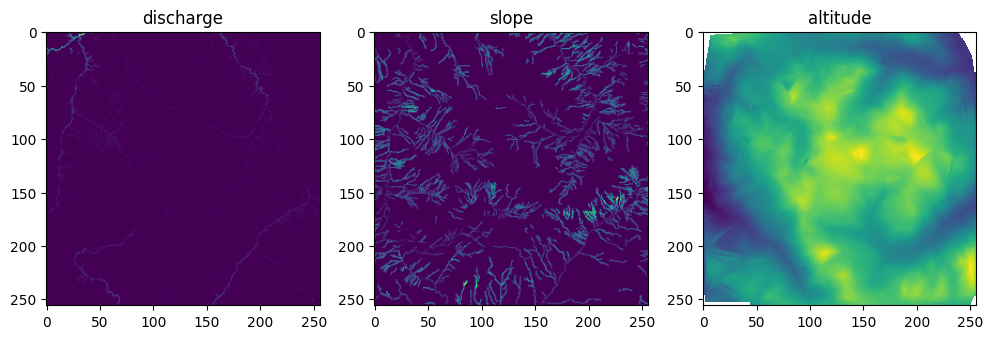

False
False
5


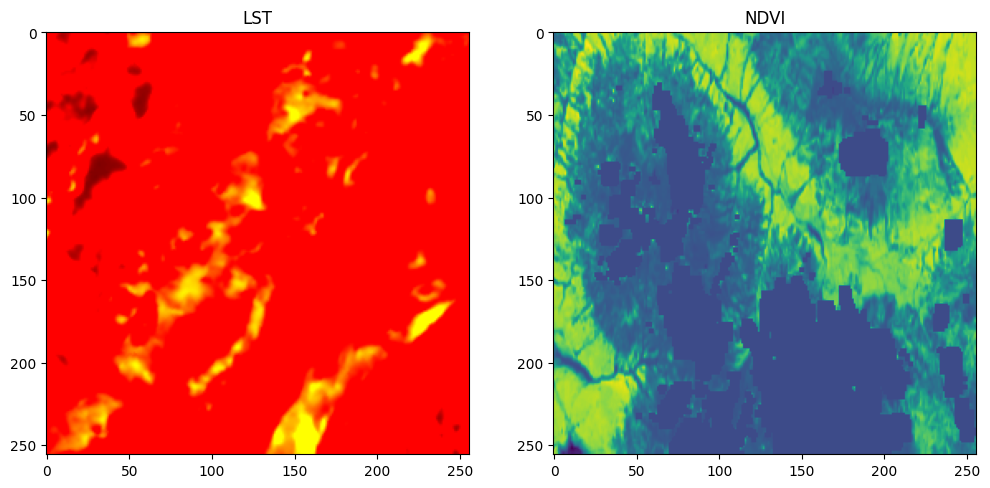

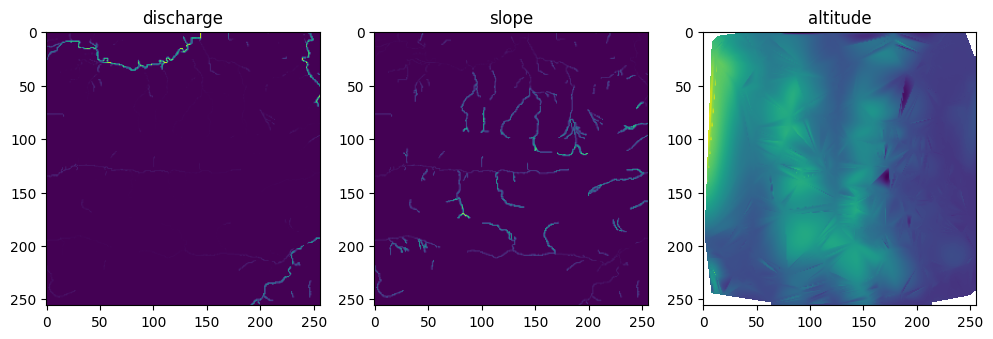

False
False
6


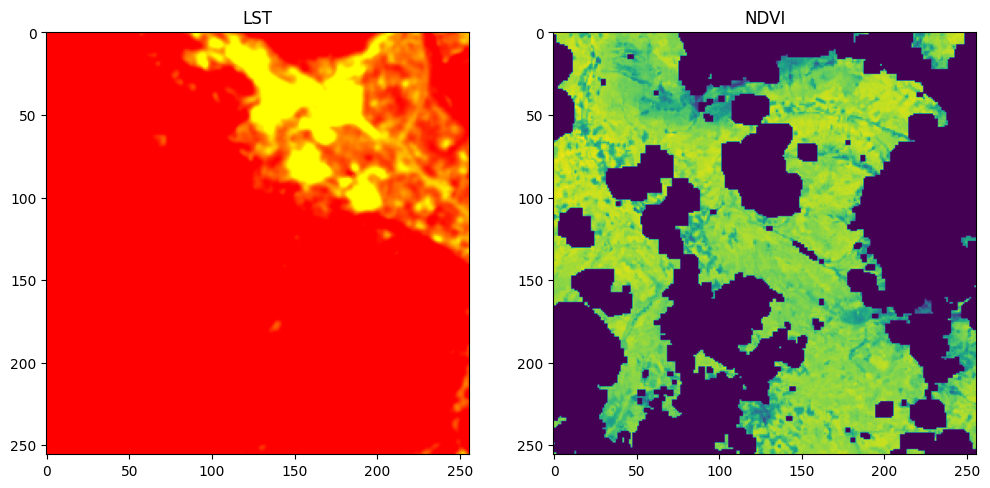

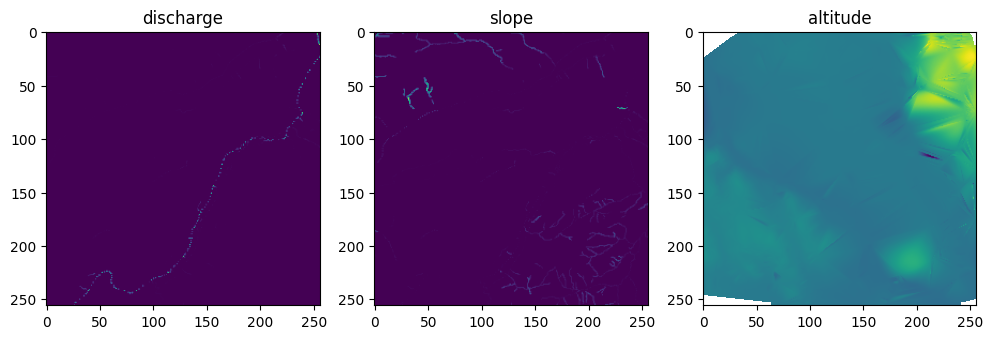

False
False
7


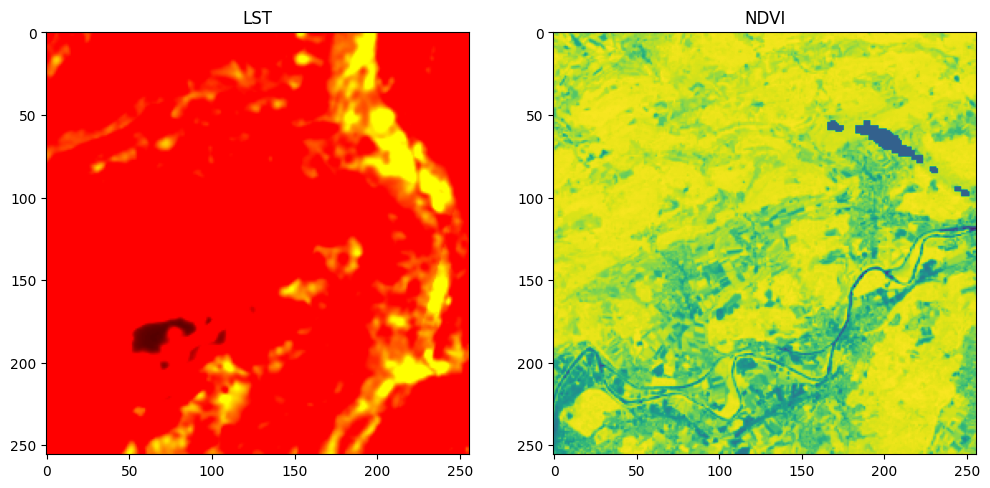

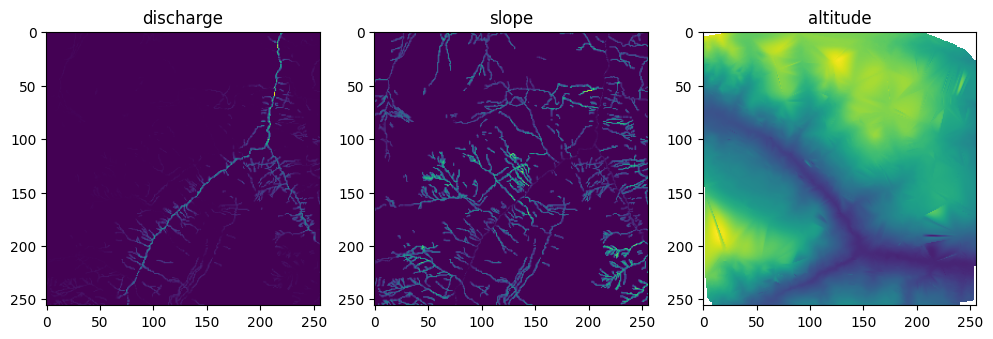

False
False
8


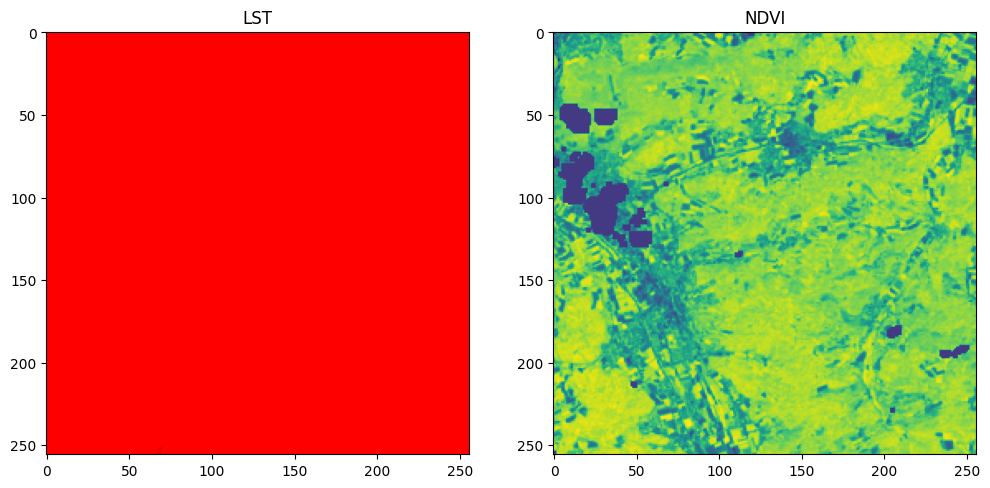

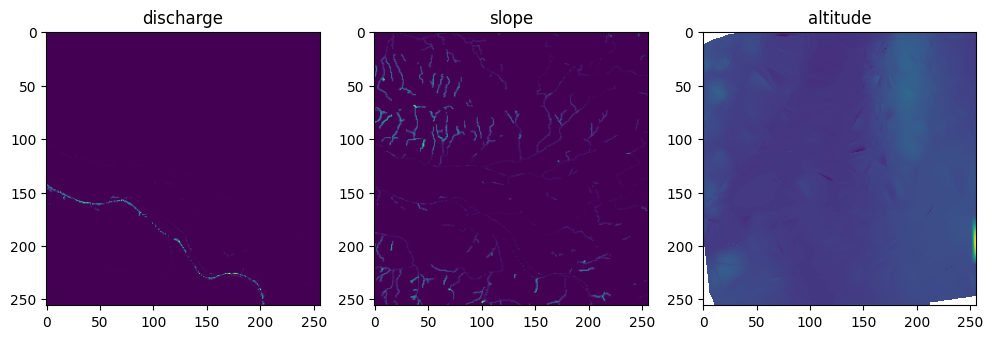

False
False
9


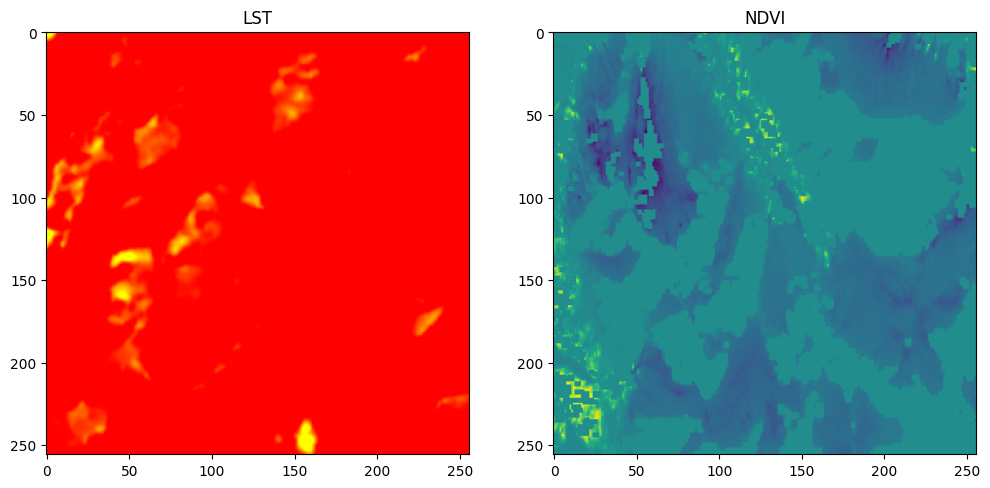

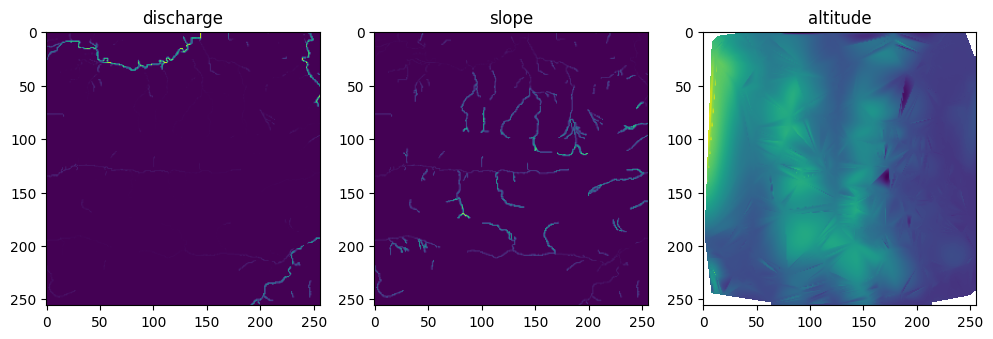

False
False
10


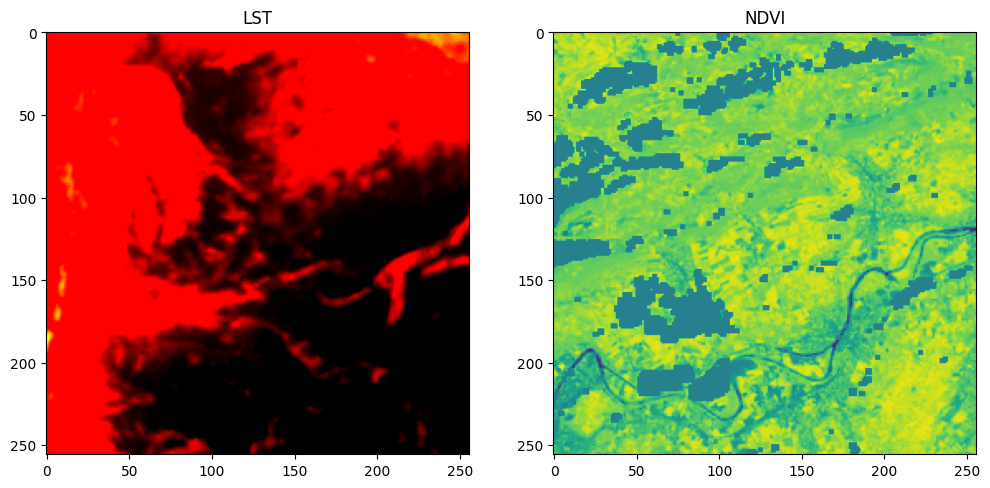

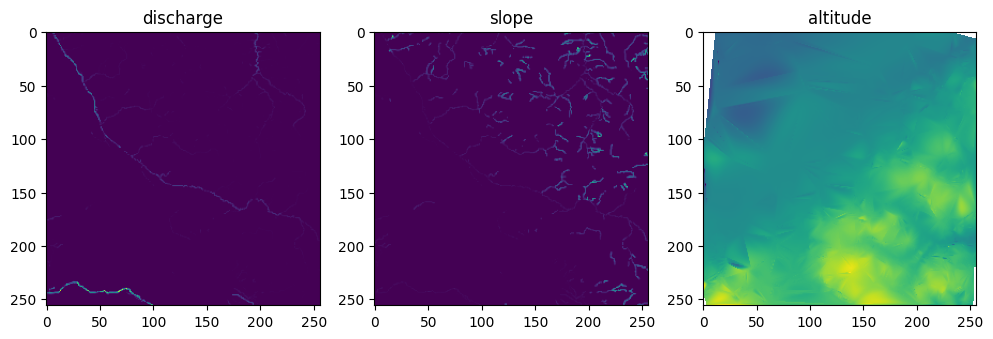

False
False
11


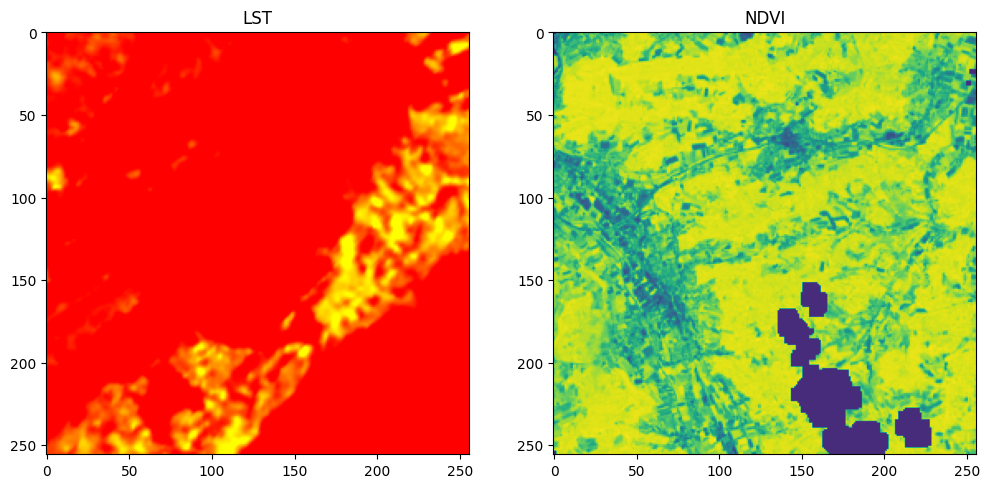

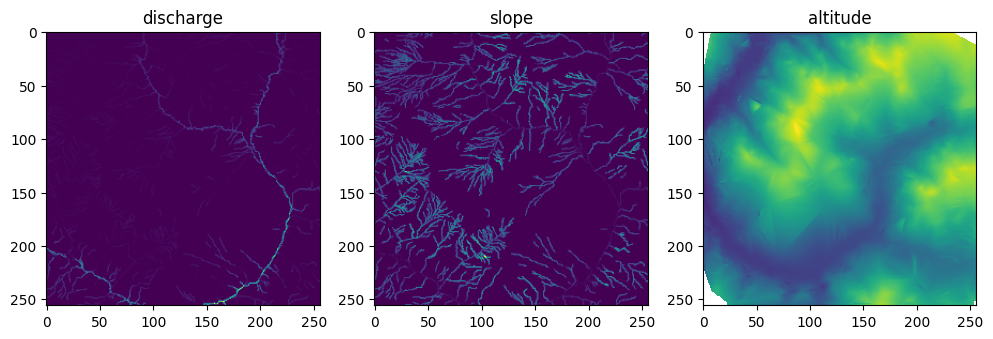

False
False
12


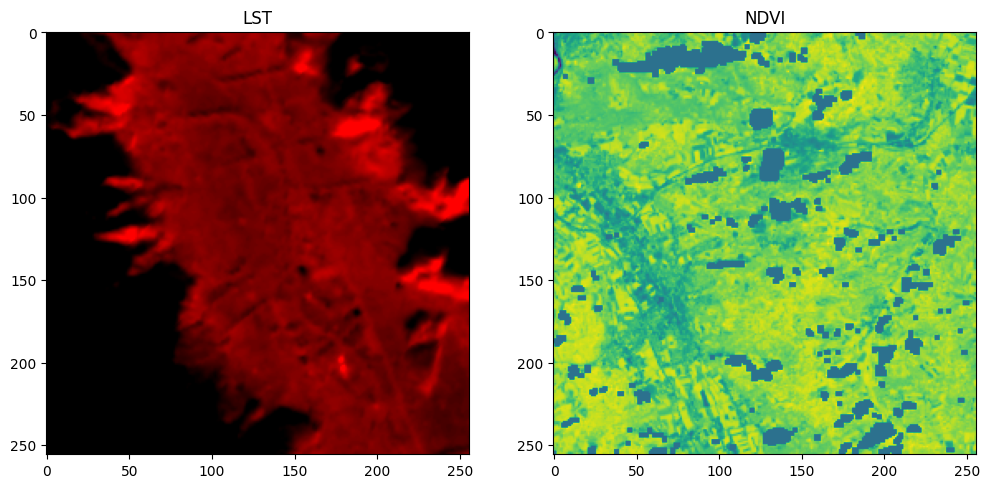

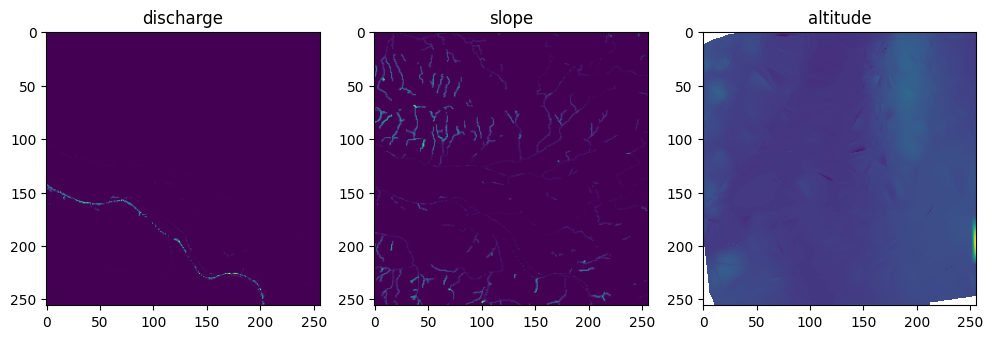

False
False
14


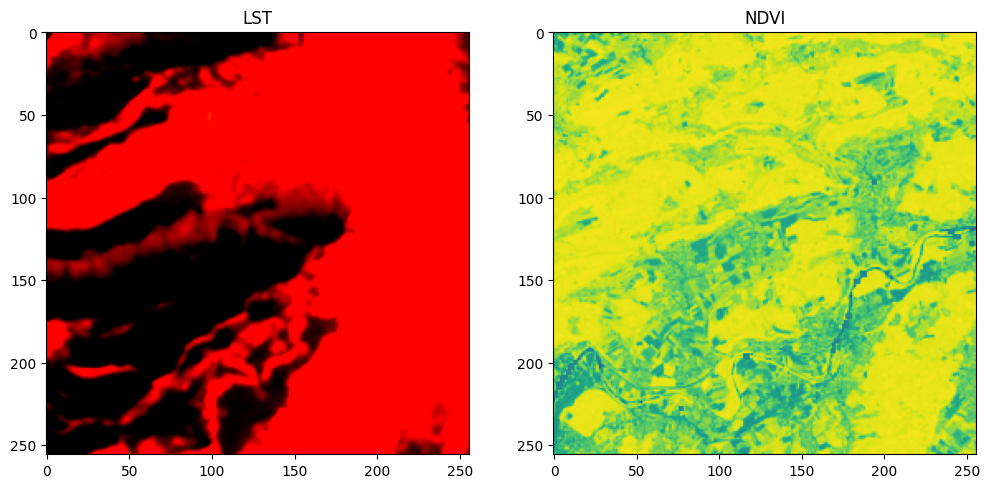

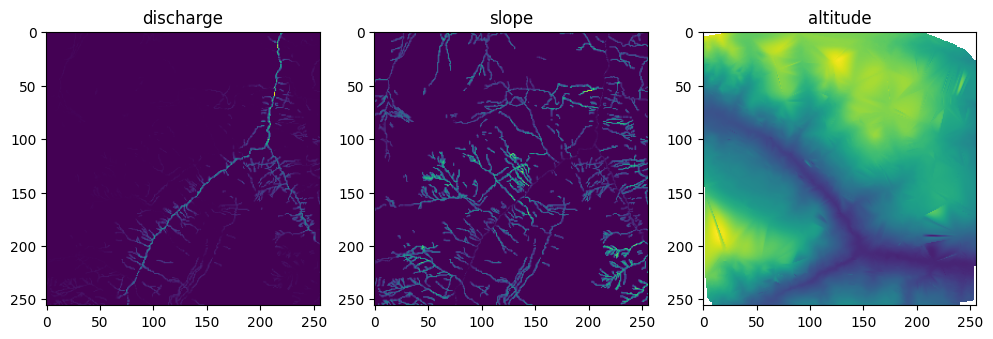

False
False
15


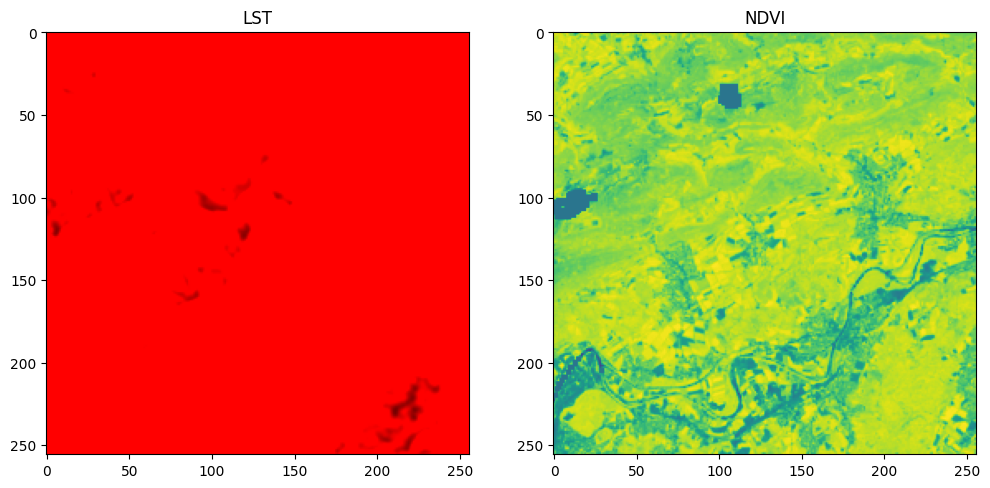

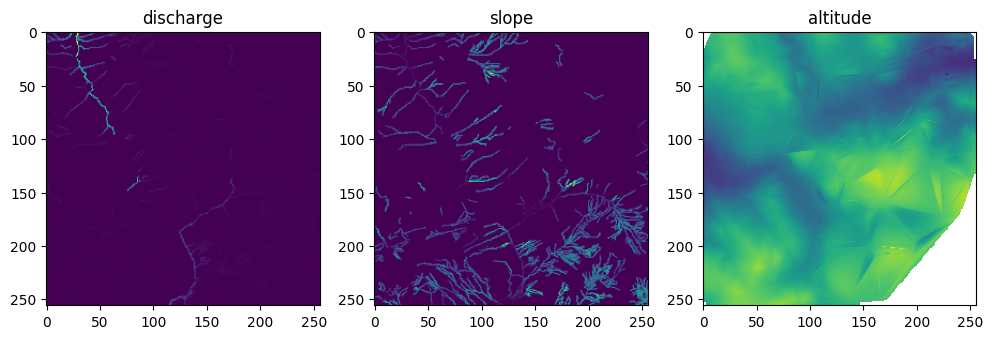

False
False
16


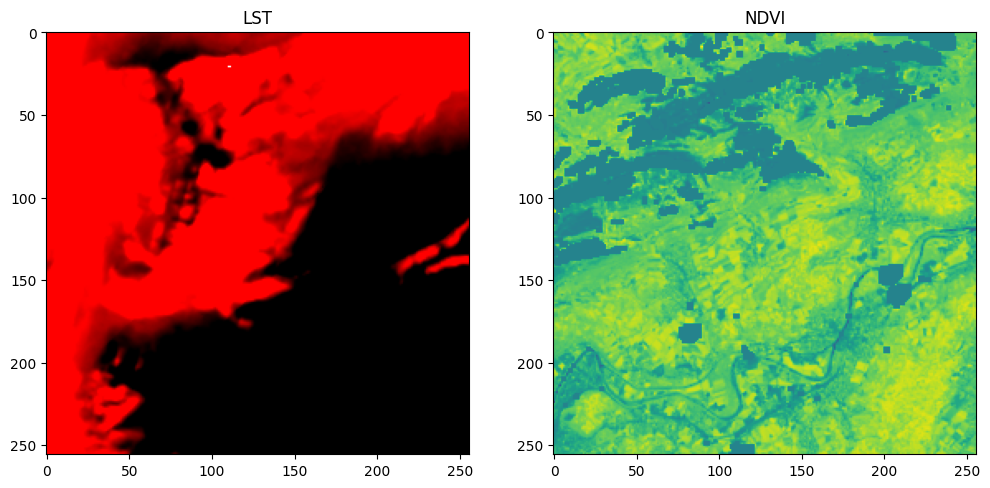

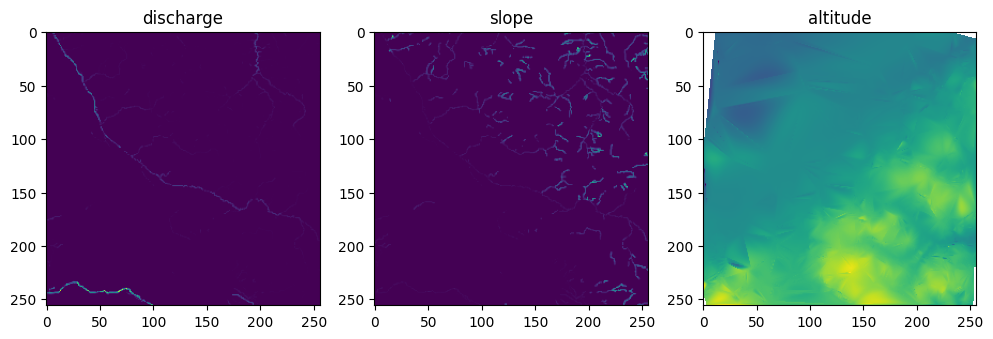

False
False
17


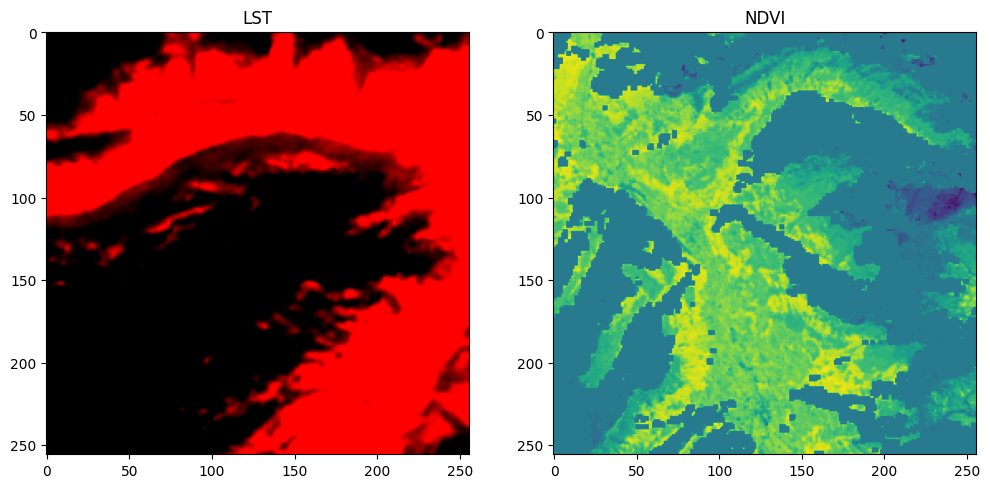

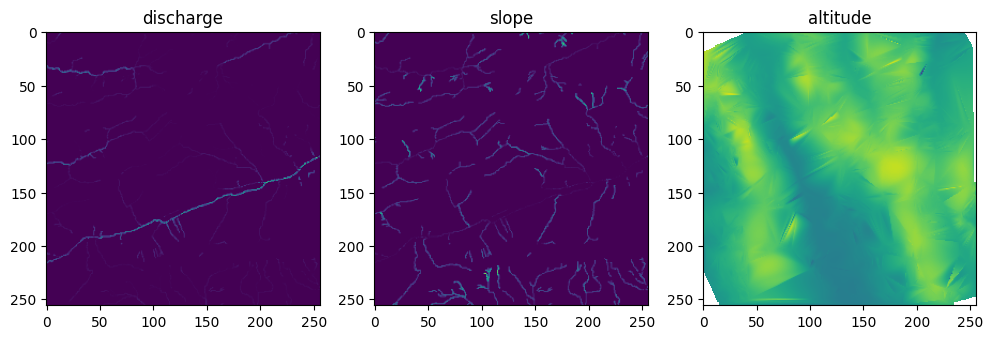

False
False
19


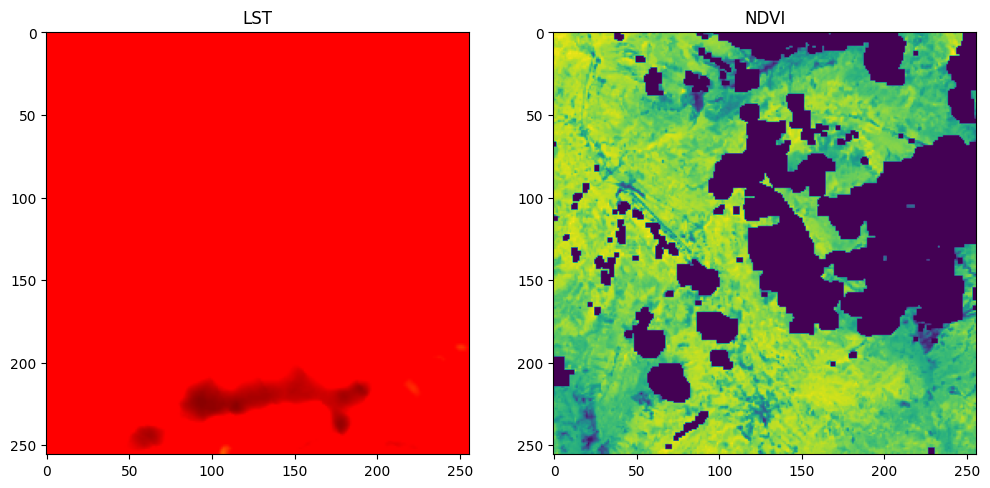

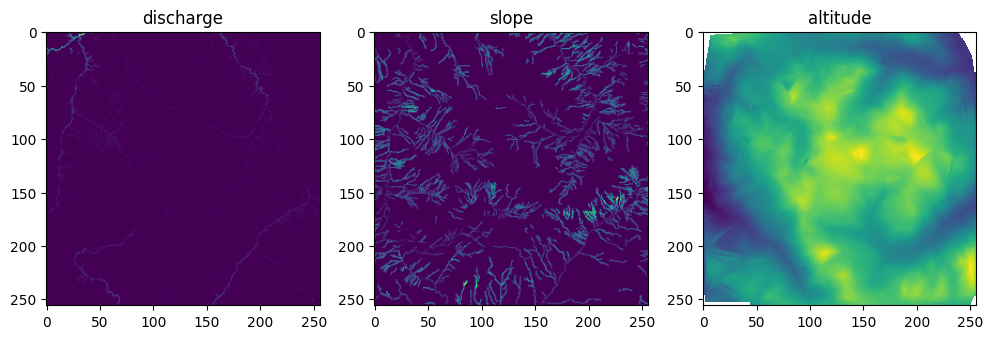

False
False
21


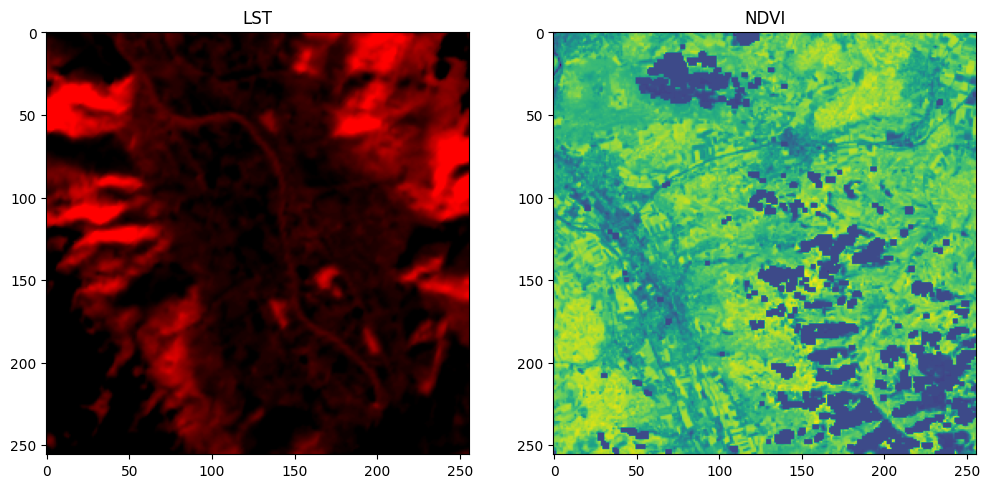

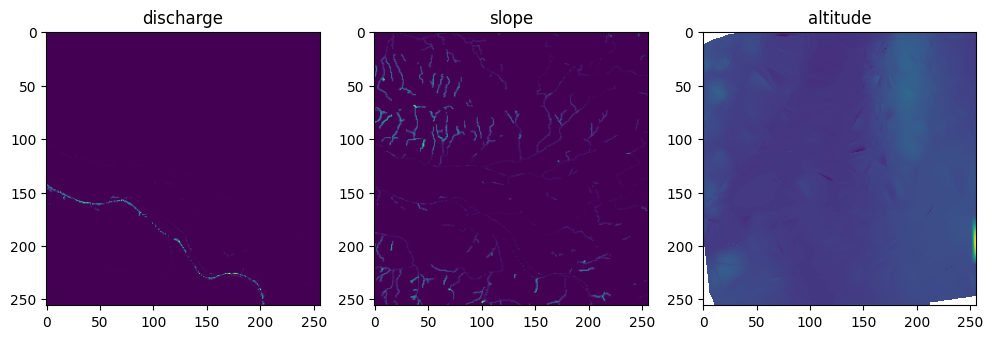

False
False
22


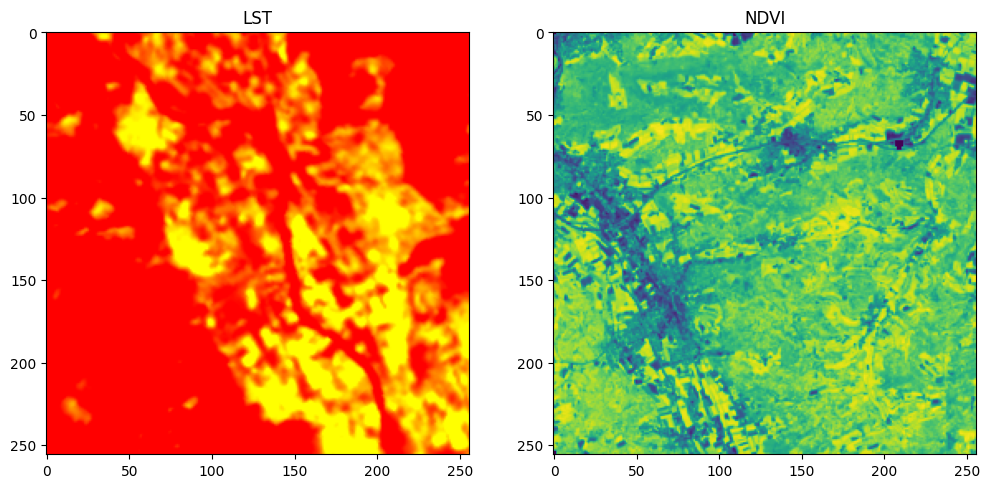

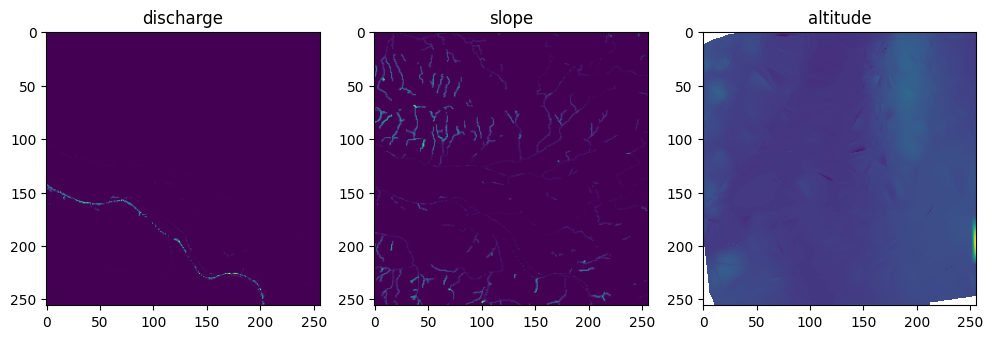

False
False
23


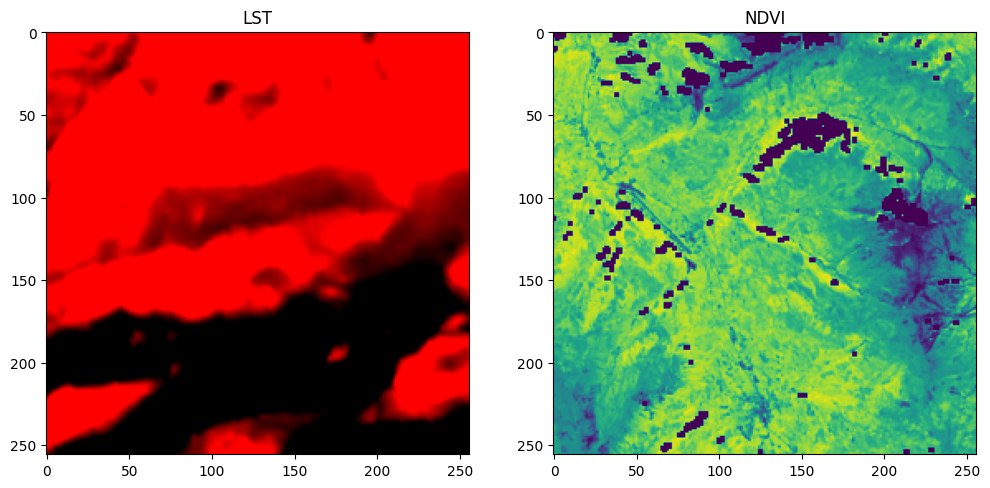

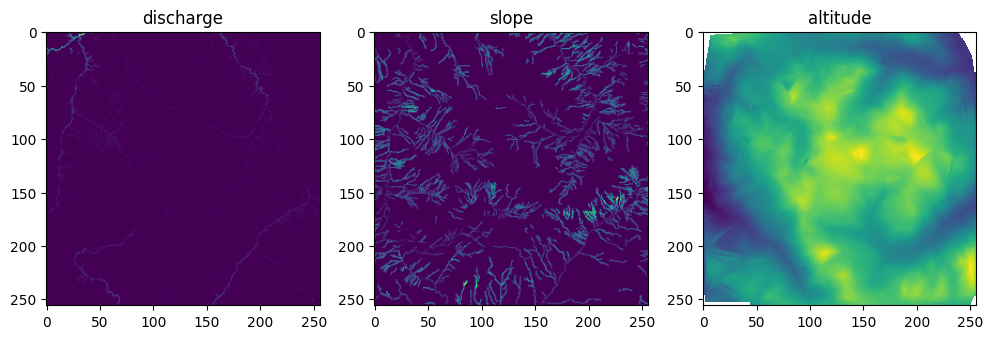

False
False
24


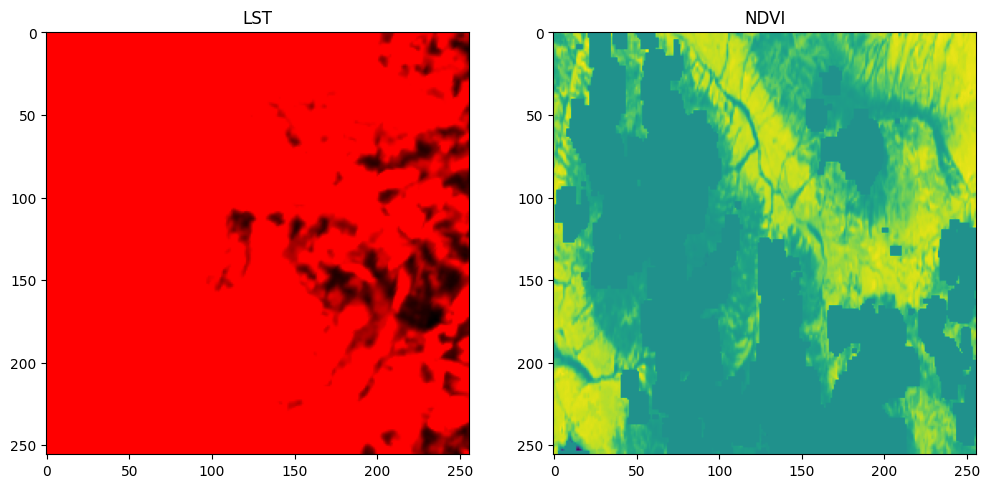

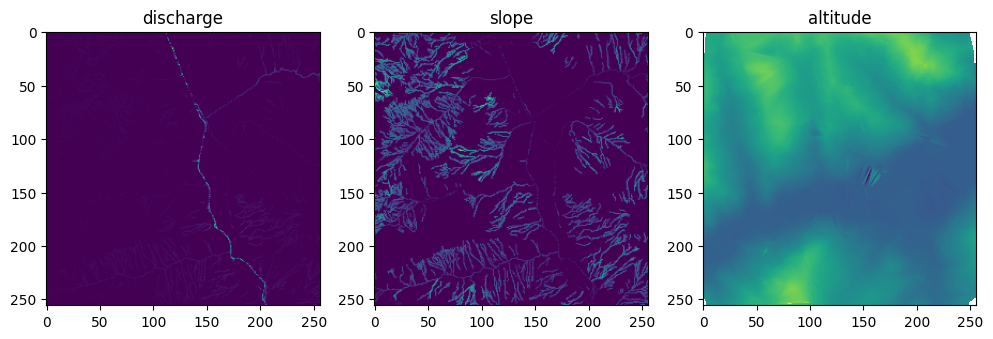

False
False
25


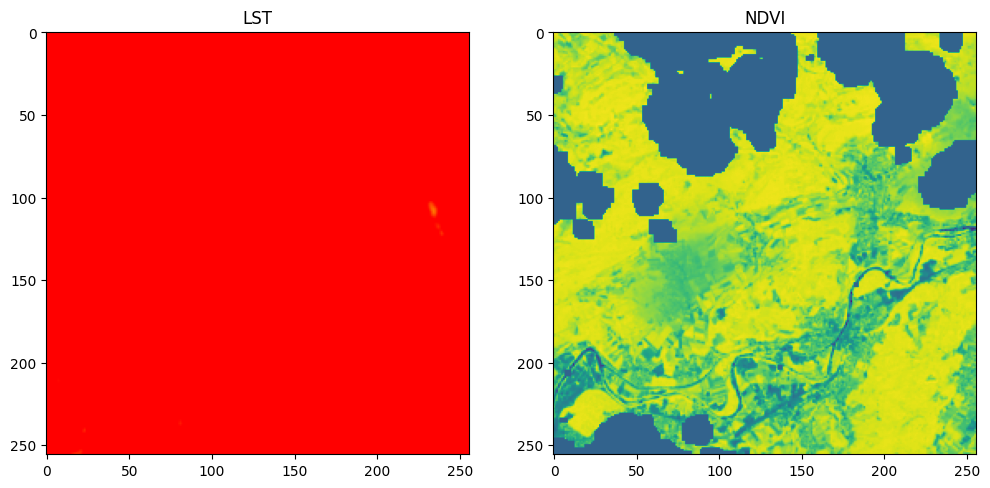

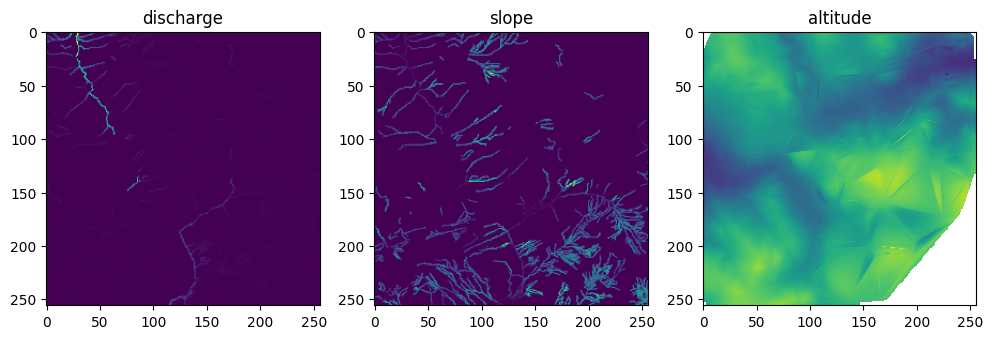

False
False
26


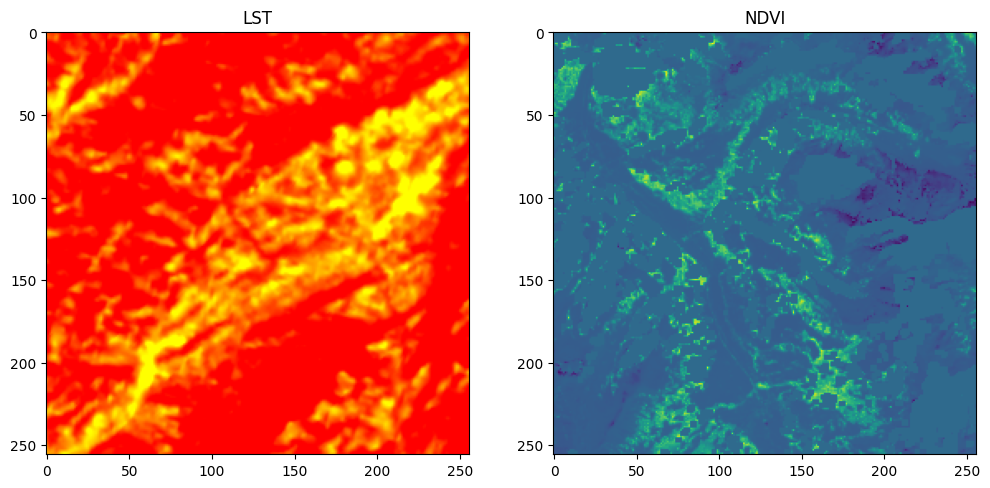

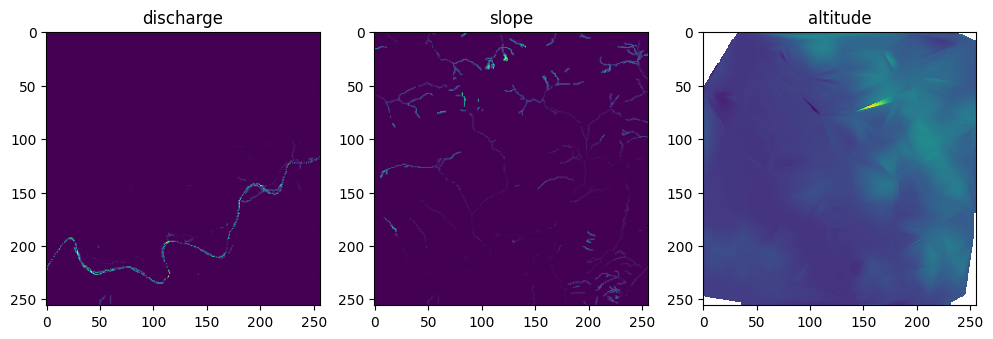

False
False
27


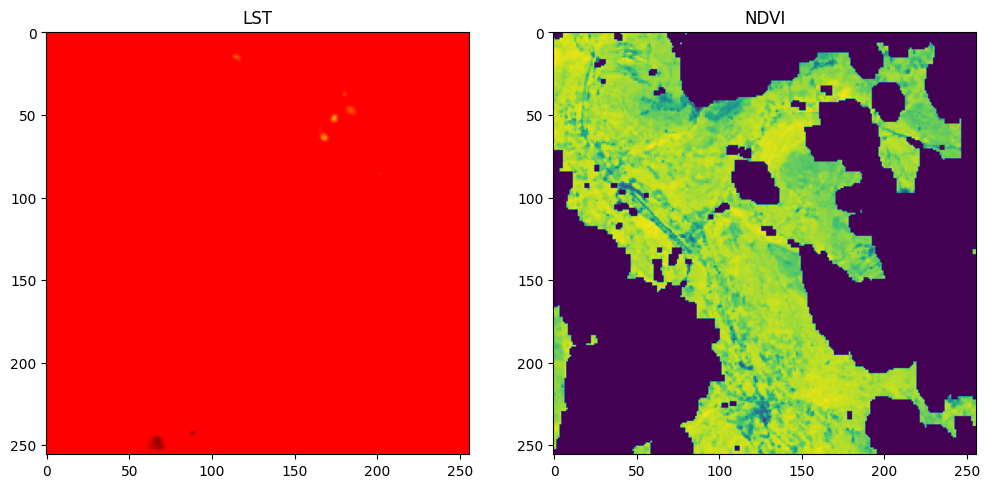

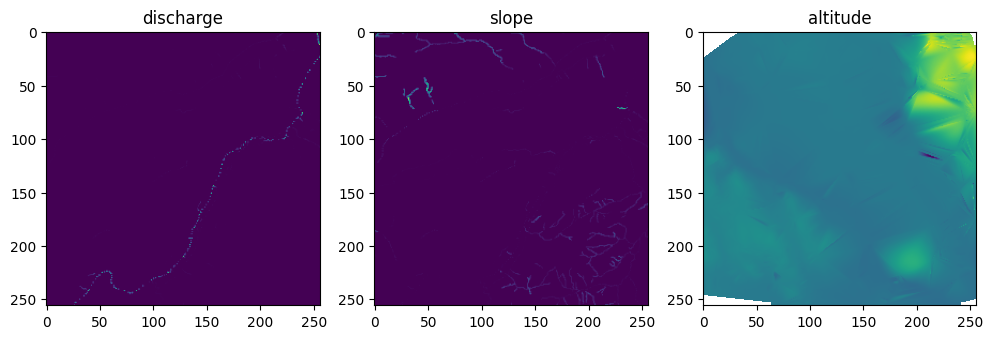

False
False
28


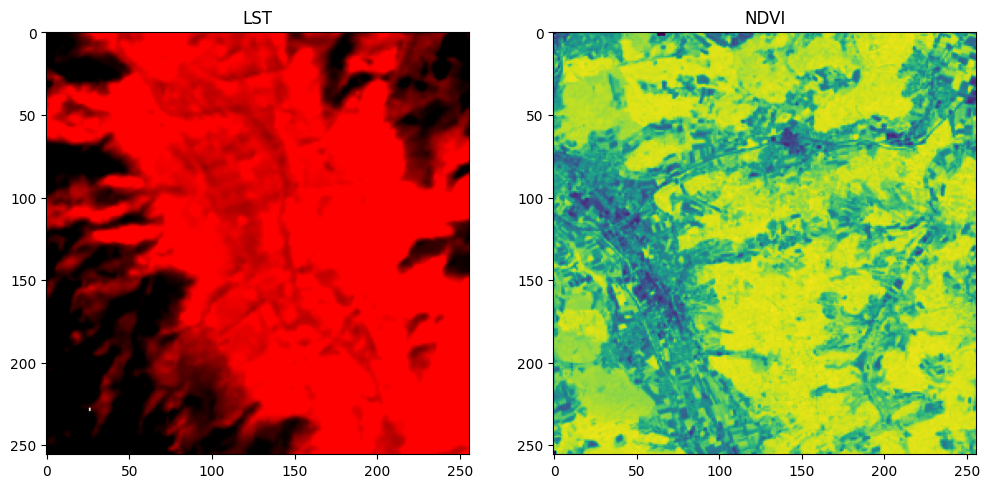

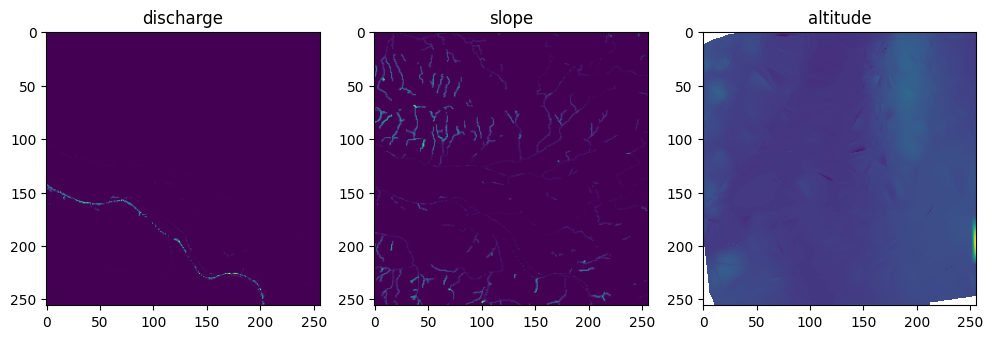

False
False
29


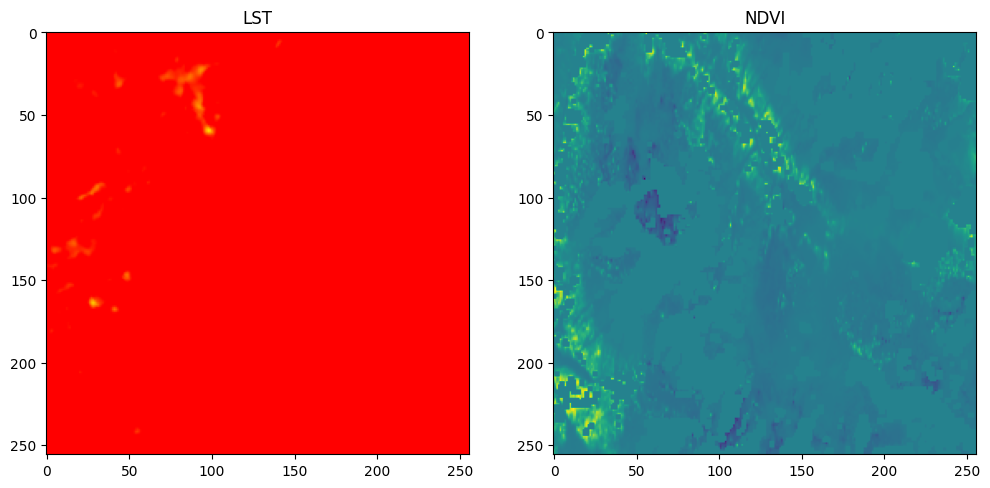

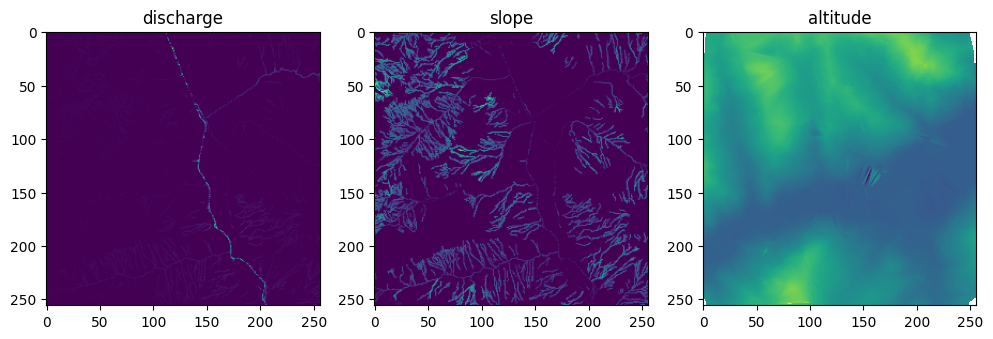

False
False


In [62]:
for i in range(total_data['lst'].shape[0]):
    if 0<i<30:
        img_lst=total_data['lst'][i]
        img_ndvi=total_data['ndvi'][i]
        
        whites = img_ndvi>=240
        percentage_w = np.sum(whites)/whites.size * 100

        img_gray = np.dot(img_lst[...,:3], [0.2989, 0.5870, 0.1140])
        whites = img_gray>=240
        percentage_w_lst = np.sum(whites)/whites.size * 100
        
        if percentage_w < 0.1 and percentage_w_lst < 0.1:
            print(i)
            fig, axs = plt.subplots(1, 2, figsize=(12, 6))
            axs[0].imshow(np.clip(img_lst*6/255,0,1))
            axs[0].set_title('LST')
            axs[1].imshow(img_ndvi)
            axs[1].set_title('NDVI')
            plt.show()
            fig, axs = plt.subplots(1, 3, figsize=(12, 6))
            axs[0].imshow(total_data['discharge'][i])
            axs[0].set_title('discharge')
            axs[1].imshow(total_data['slope'][i])
            axs[1].set_title('slope')
            axs[2].imshow(total_data['altitude'][i])
            axs[2].set_title('altitude')
            plt.show()
            print(np.array_equal(total_data['discharge'][i],total_data['slope'][i]))
            print(np.array_equal(total_data['discharge'][i],total_data['altitude'][i]))
            

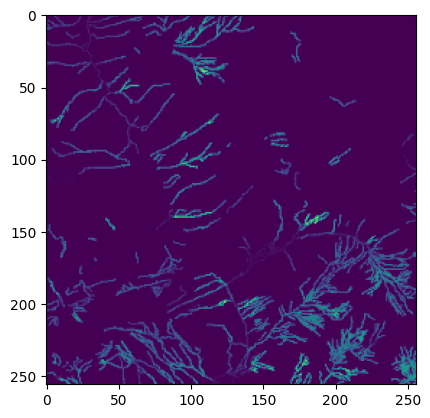

In [51]:
plt.imshow(total_data['discharge'][2])

## Statistical comparison

### Landsat and air stations (interpolated with le boiron shp)

Load data

In [29]:
# Path to the folder with the cell shapefiles
cells_folder_path = "../data/external/shp/cleaned_cells"

# Create an empty GeoDataFrame to store cells that intersect the river
intersecting_cells = gpd.GeoDataFrame()

for file in os.listdir(cells_folder_path):
    if file.endswith(".shp"):
        # Load the cell shapefile
        cell = gpd.read_file(os.path.join(cells_folder_path, file))
        
        # Check if the cell intersects with the river
        if cell.intersects(shp_boiron, align = True).any():
            print('Trobada', file)
            # If there is an intersection, add the cell to the intersecting cells GeoDataFrame
            intersecting_cells = pd.concat([intersecting_cells, cell], ignore_index=True)

Trobada rivers_grid_cell_82.shp


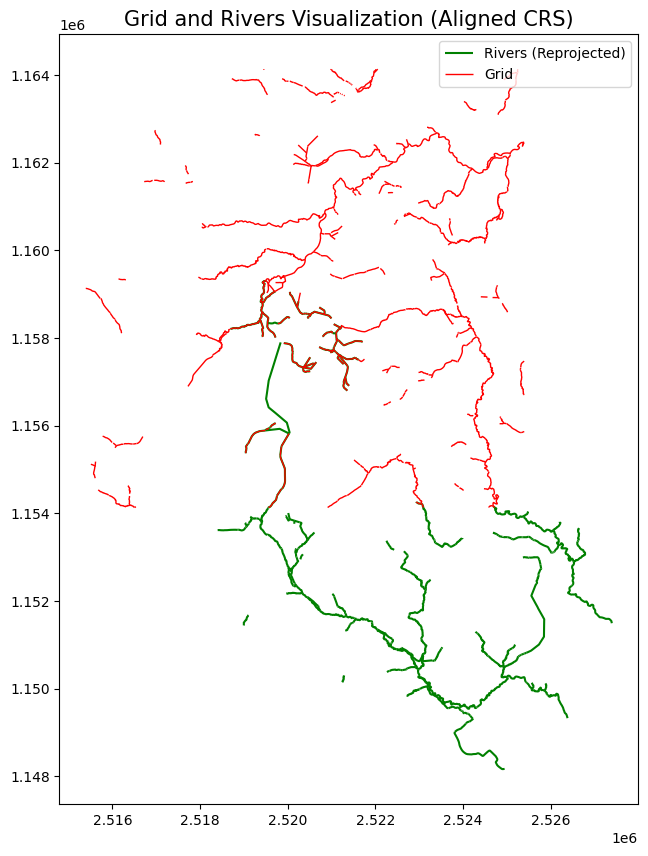

In [32]:

def visualize_grid(grid_shapefile, background_shapefile):#,boiron):
    # Load the grid shapefile (in EPSG:2056)
    grid = gpd.read_file(grid_shapefile)

    # Load the background shapefile (rivers) in EPSG:3035
    background = gpd.read_file(background_shapefile)

    # Reproject the background (rivers) to match the grid CRS (EPSG:2056)
    background_reprojected = background.to_crs(grid.crs)

    # Create a plot
    fig, ax = plt.subplots(figsize=(10, 10))

    # Plot the reprojected background (rivers)
    background_reprojected.plot(ax=ax, color='green',facecolor="none", edgecolor='black', label='Rivers (Reprojected)')

    # Plot the grid on the same axis
    grid.plot(ax=ax, facecolor="none", edgecolor="red", linewidth=1, label='Grid')

    #boiron.plot(ax=ax, facecolor="none", edgecolor="green", linewidth=1, label='Grid')
    

    # Add title and legend
    plt.title("Grid and Rivers Visualization (Aligned CRS)", fontsize=15)
    plt.legend()

    # Show the plot
    plt.show()

grid_shapefile = '../data/external/shp/cleaned_cells/rivers_grid_cell_82.shp'

# Optional: Path to a background shapefile (e.g., rivers)
background_shapefile = '../data/external/shp/Switzerland_shapefile'  # Set to None if you don't want a background
background_shapefile = '../data/external/shp/rivers/swissTLMboiron'
# Visualize the grid with a background
visualize_grid(grid_shapefile, background_shapefile)#,shp_boiron)


In [10]:
W = 256 # with 64 works LR
dir_paths = ['../data/preprocessed/lst/swissTLMboiron/','../data/raw/airtemp_interpolated']
data, time_slots = load_data(dir_paths,W,[True,False])
lst_data = data[dir_paths[0]]
airtemp_data = data[dir_paths[1]]

FileNotFoundError: [Errno 2] No such file or directory: '../data/preprocessed/lst/swissTLMboiron/'

In [70]:
indices = np.where(np.isin(time_slots[1], time_slots[0]))[0]

In [71]:
airtemp_data_filt = airtemp_data[indices]
airtemp_data_filt.shape

(18, 256, 256)

#### Visualize data

Doing 0
Time slot 2013-06


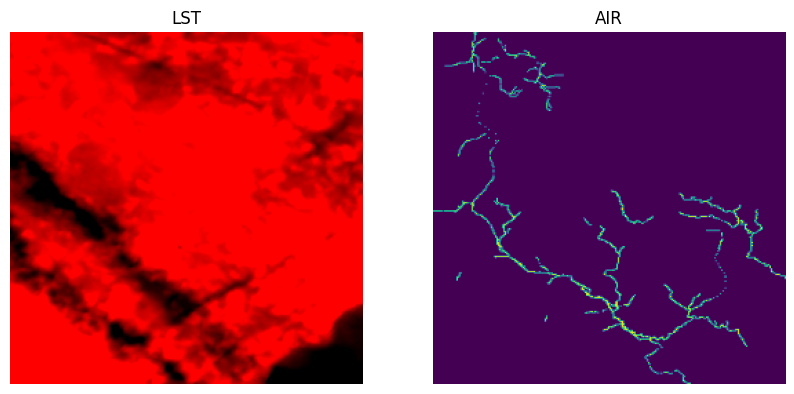

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)

Doing 1
Time slot 2014-02


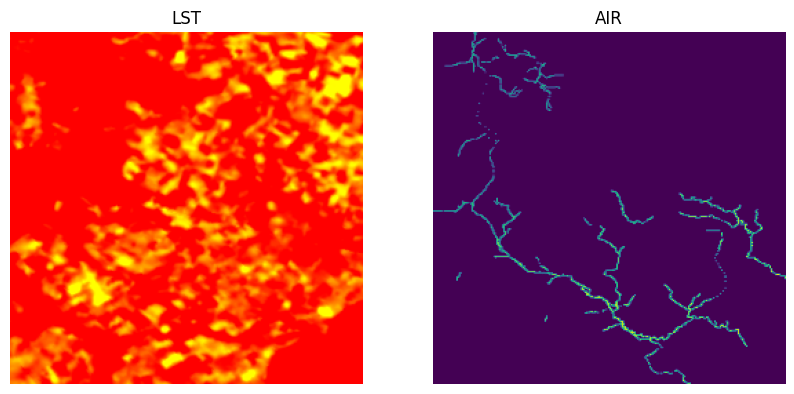

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)

Doing 2
Time slot 2014-03


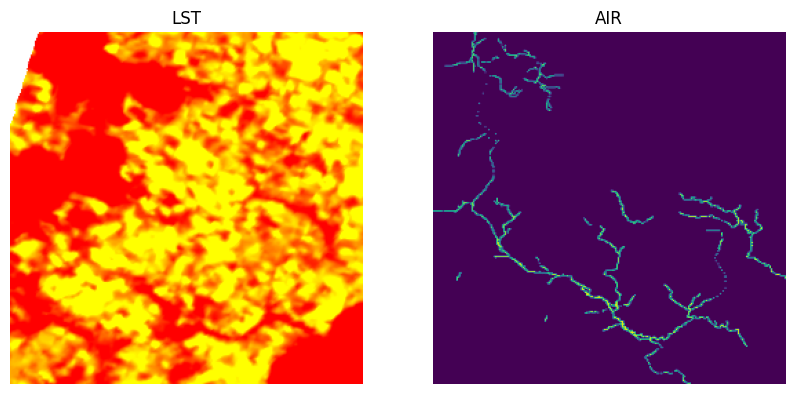

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)

Doing 3
Time slot 2014-05


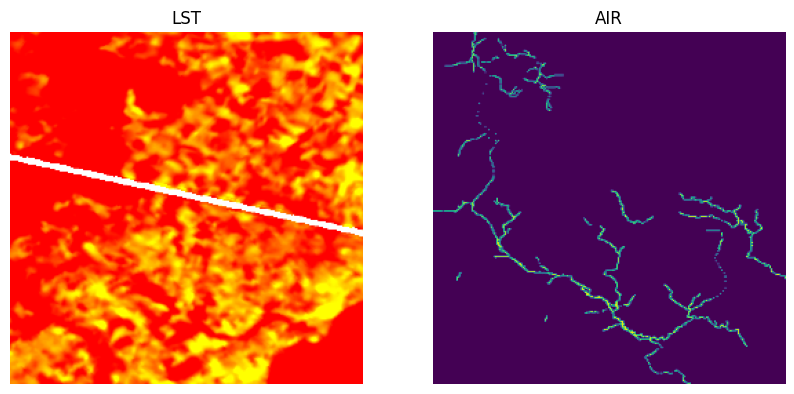

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)

Doing 4
Time slot 2014-11


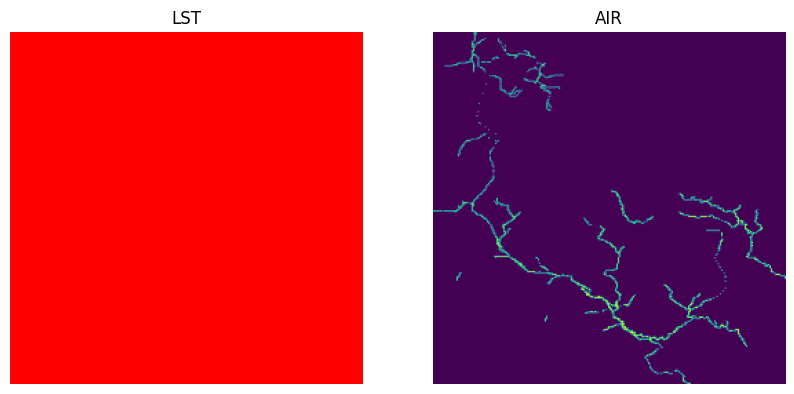

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)

Doing 5
Time slot 2015-03


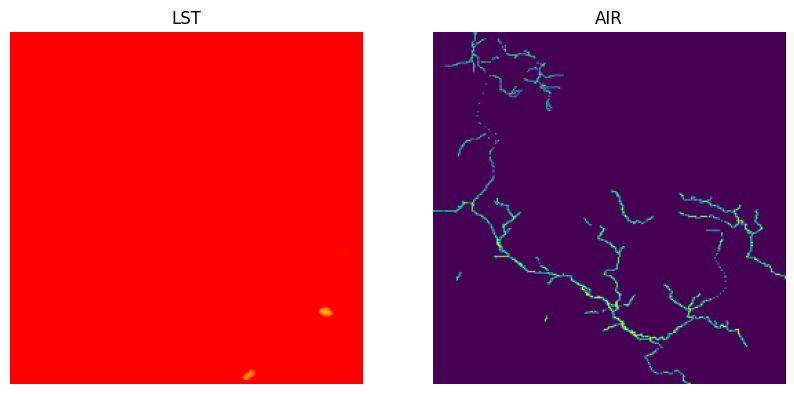

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)

Doing 6
Time slot 2015-04


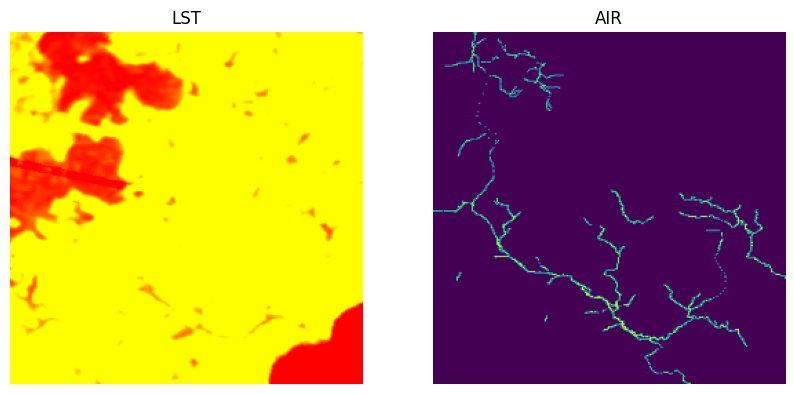

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)

Doing 7
Time slot 2015-07


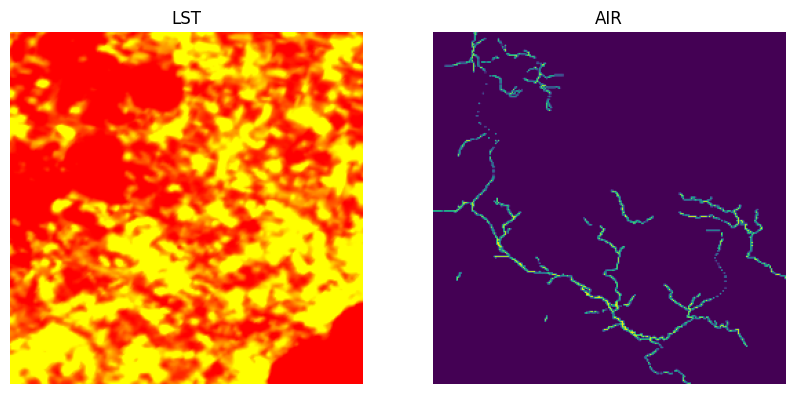

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)

Doing 8
Time slot 2016-05


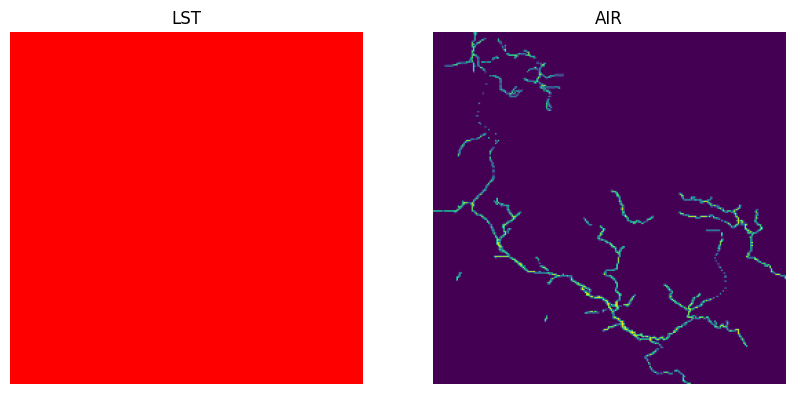

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)

Doing 9
Time slot 2016-08


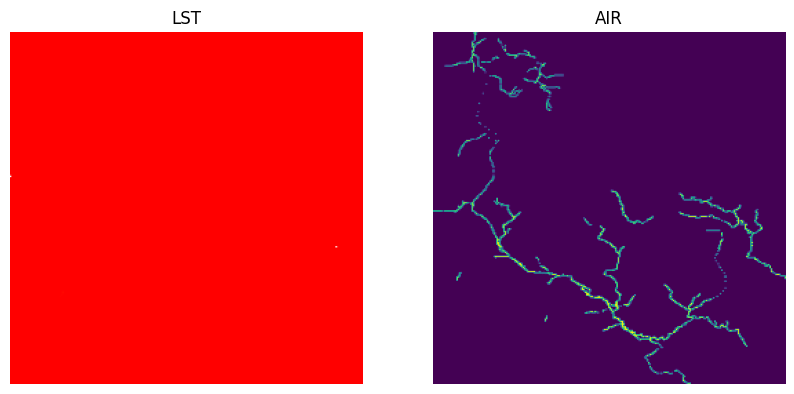

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)

Doing 10
Time slot 2016-09


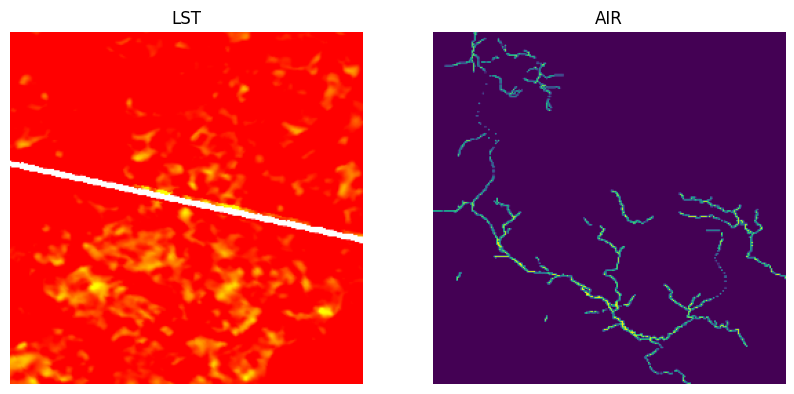

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)

Doing 11
Time slot 2017-01


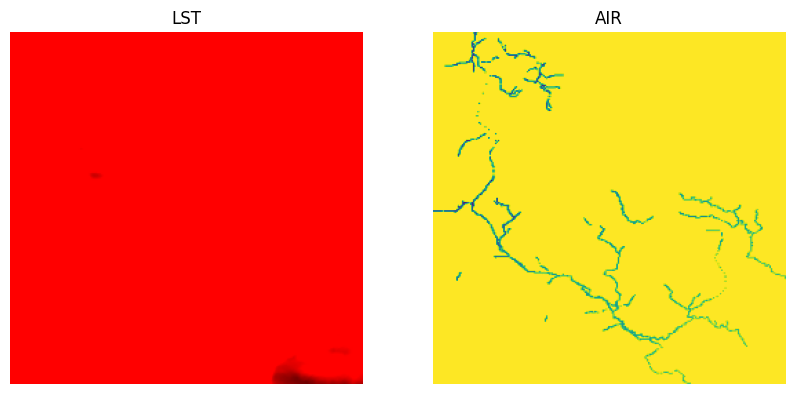

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)

Doing 12
Time slot 2017-06


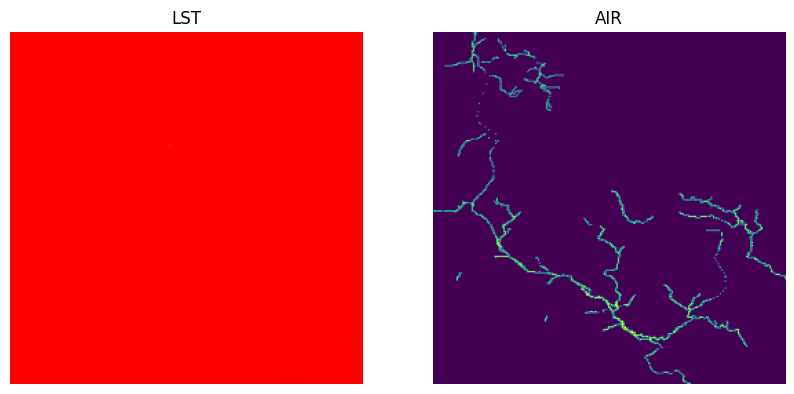

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)

Doing 13
Time slot 2017-07


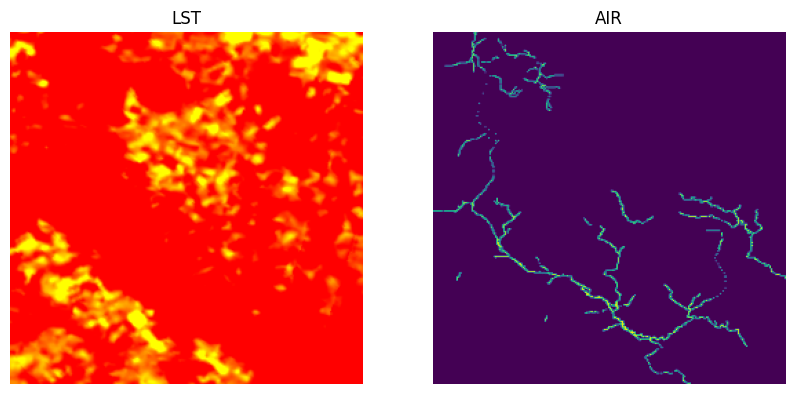

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)

Doing 14
Time slot 2017-12


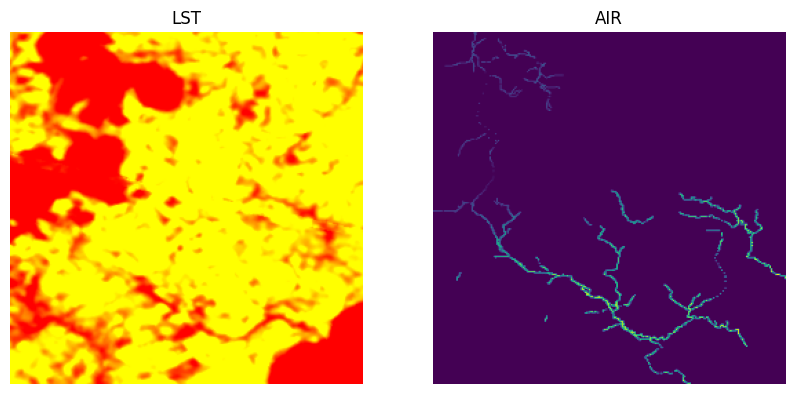

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)

Doing 15
Time slot 2018-05


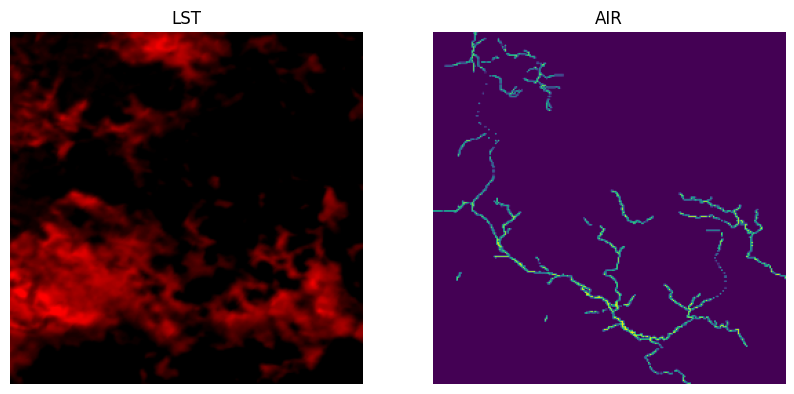

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)

Doing 16
Time slot 2018-10


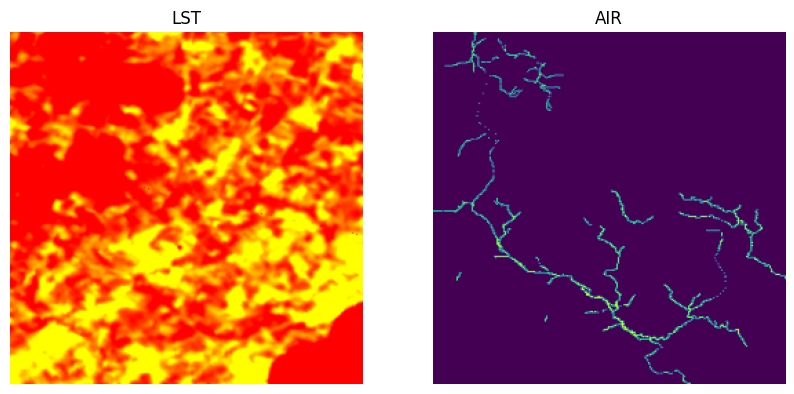

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)

Doing 17
Time slot 2019-02


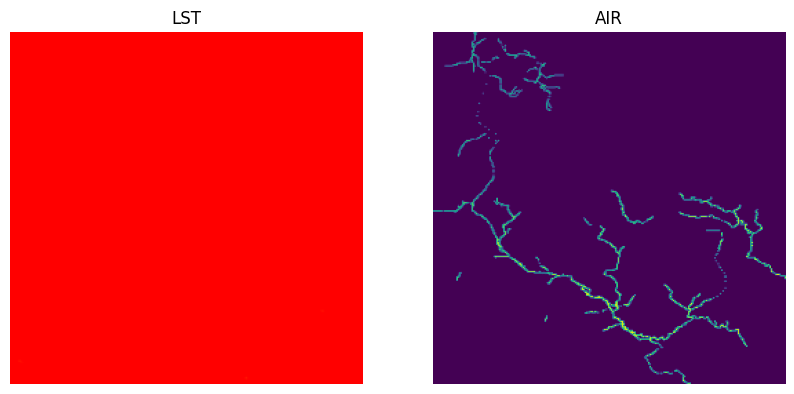

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)



In [72]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming lst_data and airtemp_data are lists of arrays
for i,(img_data, airtemp_dat) in enumerate(zip(lst_data, airtemp_data_filt)):
    print('Doing',i)
    print('Time slot', time_slots[0][i])
    # Create a figure with two subplots (1 row, 2 columns)
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))  # Adjust the figure size if needed

    # Plot the first image (LST)
    axes[0].imshow(np.clip(img_data * (6/255), 0, 1))
    axes[0].set_title('LST')
    axes[0].axis('off')  # Remove the axis

    # Plot the second image (AIR)
    axes[1].imshow(airtemp_dat)
    axes[1].set_title('AIR')
    axes[1].axis('off')  # Remove the axis

    # Show the images side by side
    plt.show()

    # Optionally, print the shape of the images
    print('LST Shape:', img_data.shape)
    print('AIR Shape:', airtemp_dat.shape)
    print()


#### Filter to obtain only river data

In [73]:
river_mask = airtemp_data[0]  # Cambia el índice según sea necesario

# Imprimir la forma de la imagen seleccionada
print('Selected image shape:', river_mask.shape)

Selected image shape: (256, 256)


In [74]:
river_mask_expanded = np.expand_dims(river_mask, axis=-1)  # Expande para tener forma (height, width, 1)
river_mask_expanded = np.repeat(river_mask_expanded, lst_data.shape[-1], axis=-1)  # Expande a (height, width, 3)

# Aplica la máscara solo a las entradas (inputs)
masked_inputs = []

for input_img in lst_data:
    masked_input = input_img * river_mask_expanded  # Aplica la máscara a los inputs
    masked_inputs.append(masked_input)

# Convierte de nuevo a arrays de numpy
masked_inputs = np.array(masked_inputs)


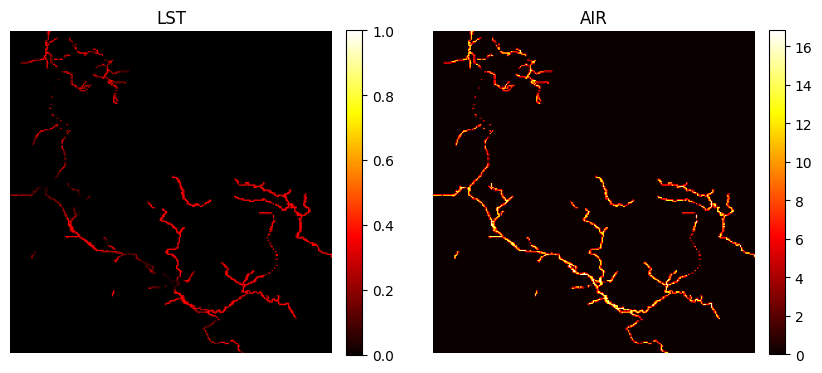

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)



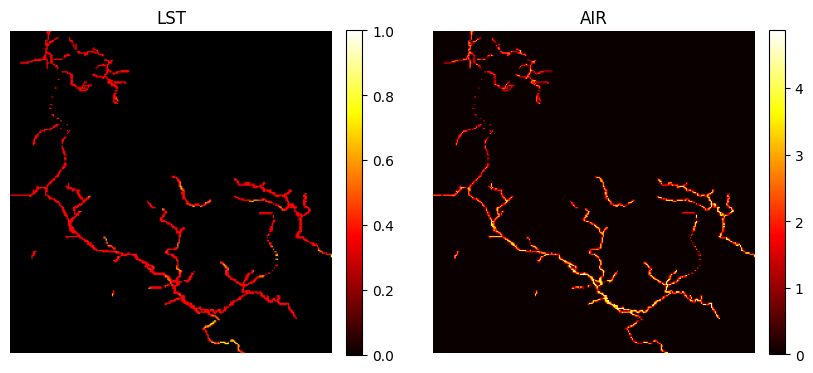

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)



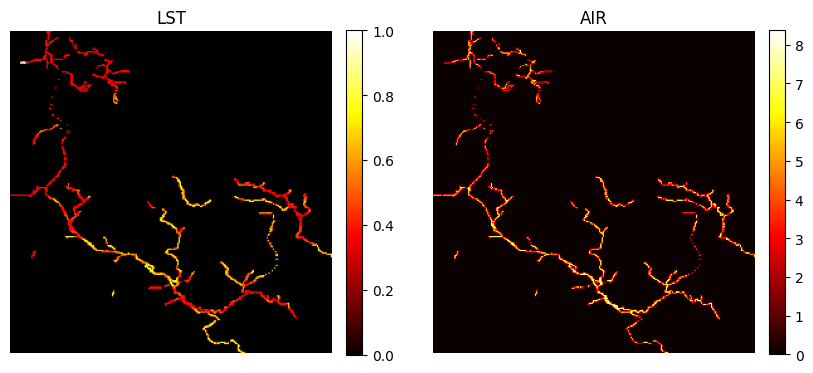

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)



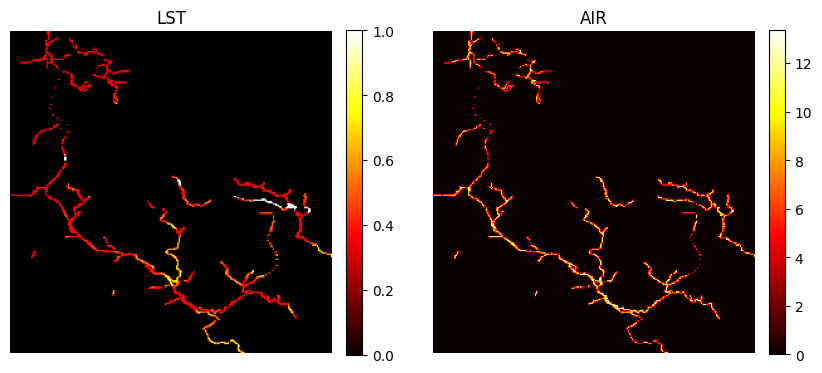

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)



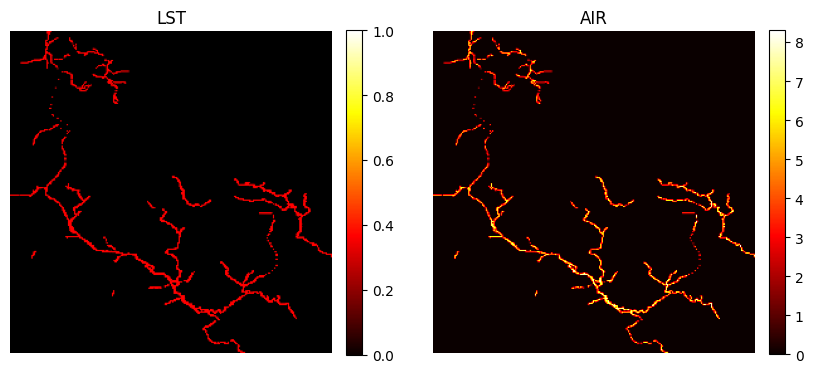

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)



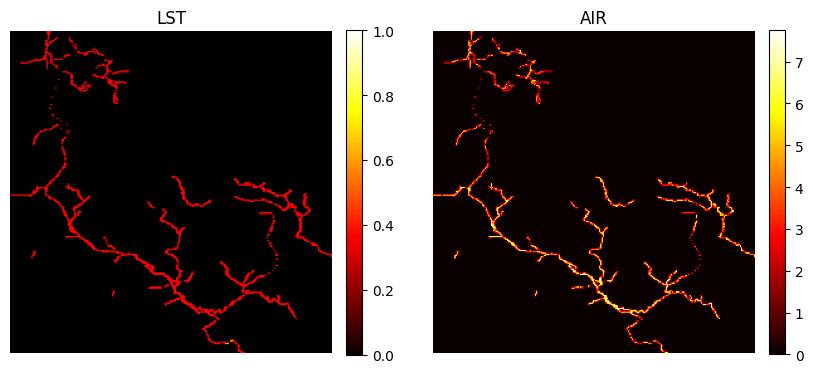

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)



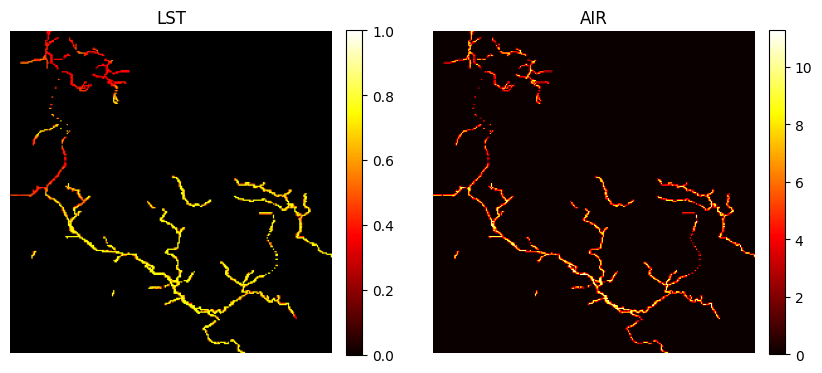

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)



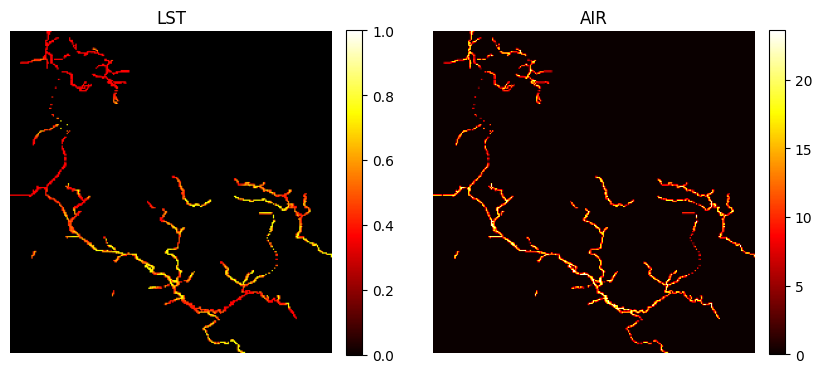

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)



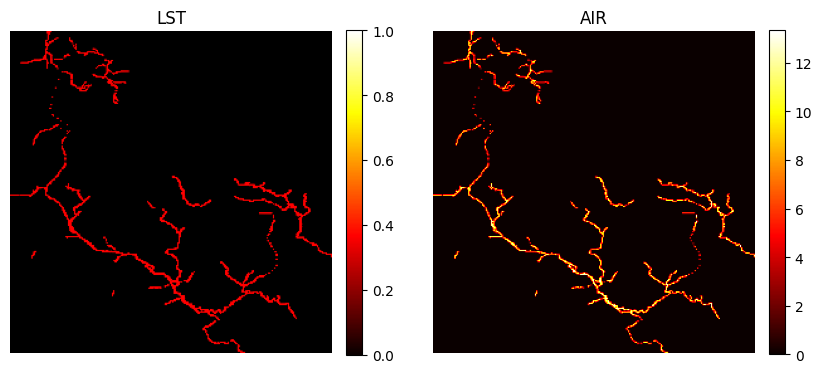

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)



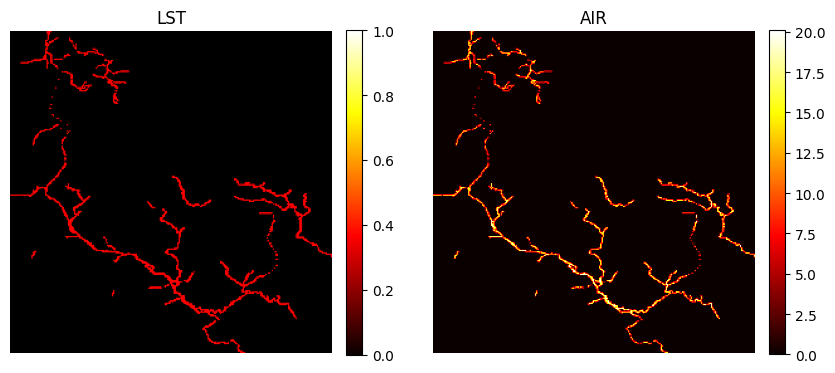

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)



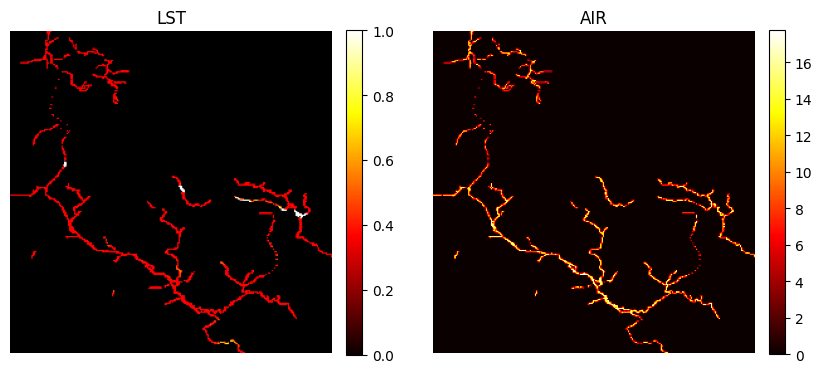

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)



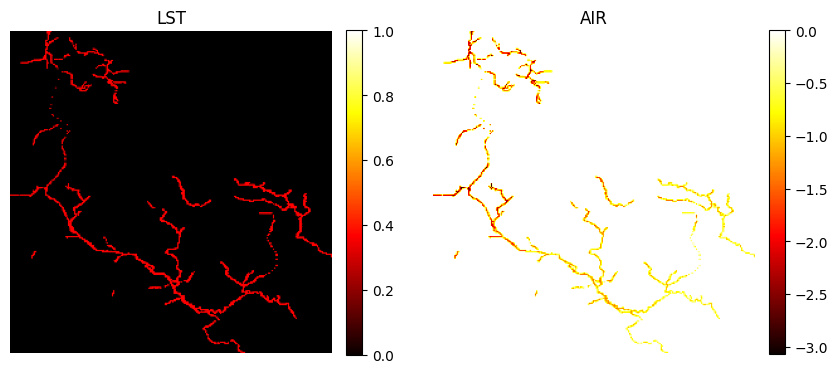

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)



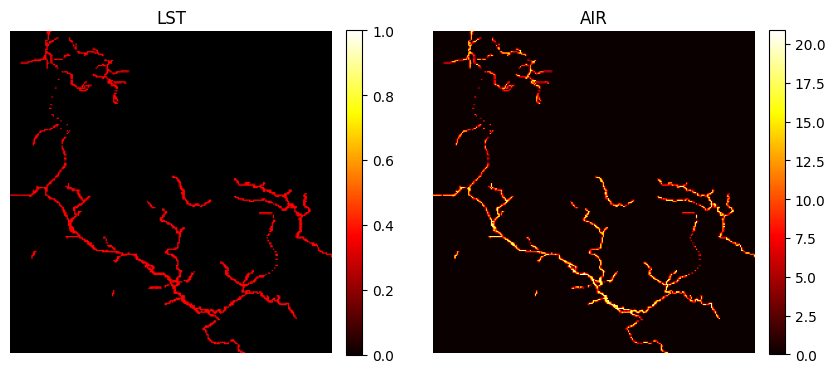

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)



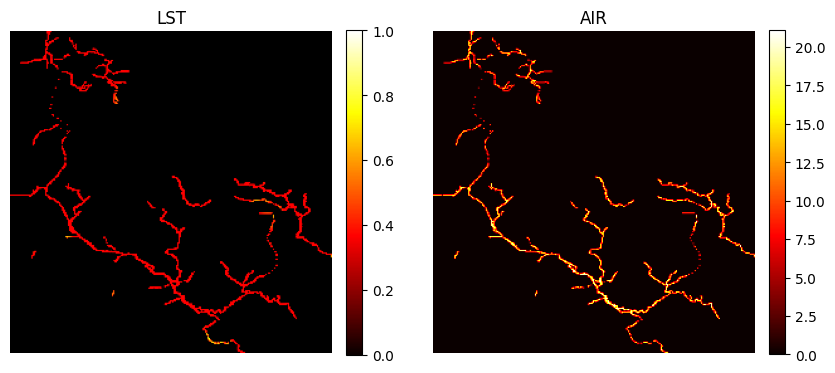

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)



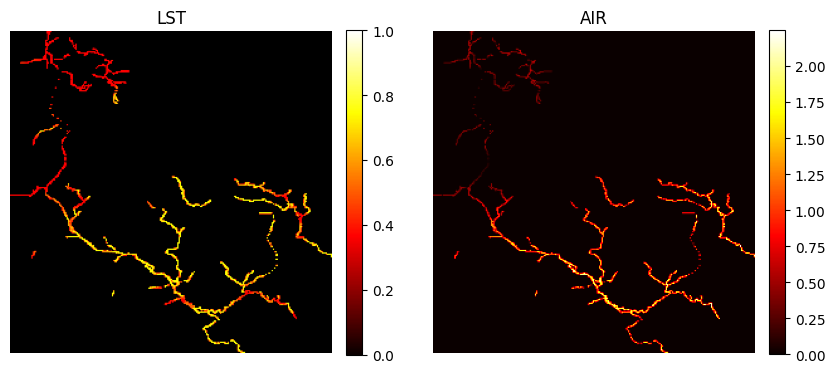

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)



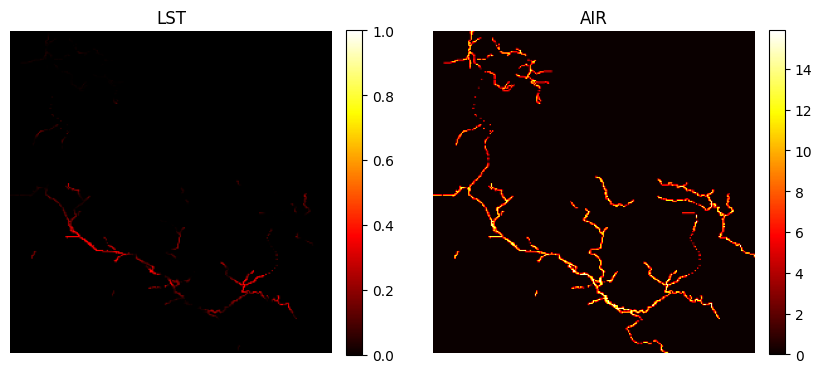

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)



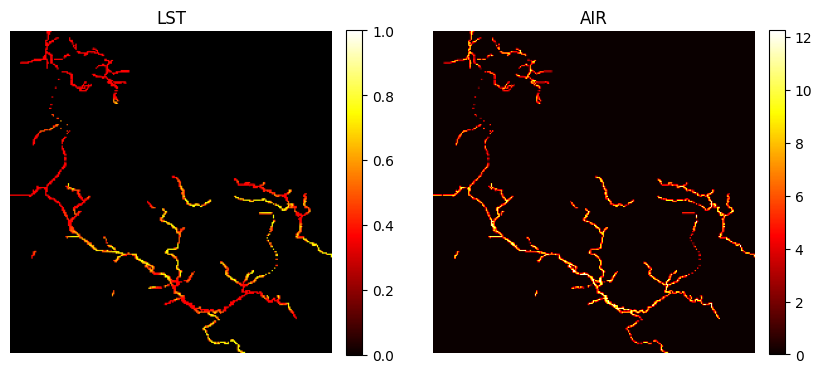

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)



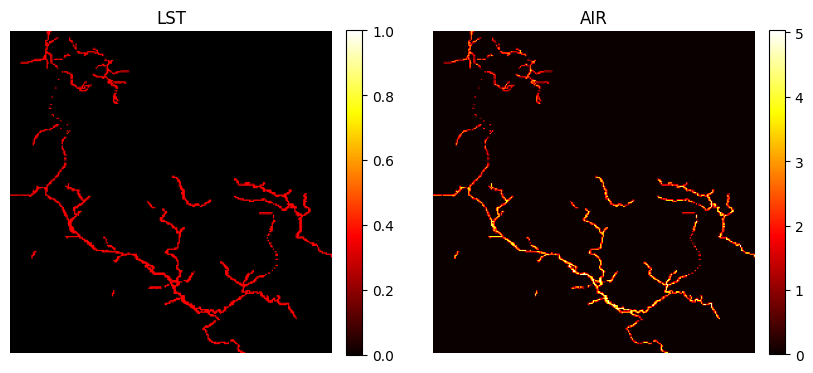

LST Shape: (256, 256, 3)
AIR Shape: (256, 256)



In [75]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming masked_inputs and airtemp_data are lists of arrays
for img_data, airtemp_dat in zip(masked_inputs, airtemp_data_filt):
    # Create a figure with two subplots (1 row, 2 columns)
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))  # Adjust the figure size if needed

    # Plot the first image (LST)
    img1 = axes[0].imshow(np.clip(img_data * (6/255), 0, 1), cmap='hot')
    axes[0].set_title('LST')
    axes[0].axis('off')  # Remove the axis

    # Add colorbar next to the first subplot
    cbar1 = fig.colorbar(img1, ax=axes[0], orientation='vertical', fraction=0.046, pad=0.04)

    # Plot the second image (AIR)
    img2 = axes[1].imshow(airtemp_dat, cmap='hot')
    axes[1].set_title('AIR')
    axes[1].axis('off')  # Remove the axis

    # Add colorbar next to the second subplot
    cbar2 = fig.colorbar(img2, ax=axes[1], orientation='vertical', fraction=0.046, pad=0.04)

    # Show the images side by side
    plt.show()

    # Optionally, print the shape of the images
    print('LST Shape:', img_data.shape)
    print('AIR Shape:', airtemp_dat.shape)
    print()


In [76]:
airtemp_data_flatten = airtemp_data_filt.reshape(airtemp_data_filt.shape[0], -1)

In [77]:
river_indices = np.nonzero(airtemp_data_filt[0].reshape(-1))[0]
len(river_indices)

4052

In [78]:
filtered_lst = []
filtered_airtemp = []
del_indices = []
for i in range(masked_inputs.shape[0]):
  img_rgb = masked_inputs[i]
  img_gray = np.dot(img_rgb[...,:3], [0.2989, 0.5870, 0.1140]) # turn to gray image, calculate the weighted average of each channel contribution
  river = img_gray.flatten()[river_indices]
  air_filt = airtemp_data_flatten[i][river_indices]
  filtered_lst.append(river)
  filtered_airtemp.append(air_filt)

filtered_lst = np.array(filtered_lst)
filtered_airtemp = np.array(filtered_airtemp)
print(filtered_lst.shape, filtered_airtemp.shape)

(18, 4052) (18, 4052)


In [14]:
temp_1 = filtered_lst[0]
temp_2 = filtered_airtemp[0]
differences = np.array(temp_1) - np.array(temp_2)

plt.plot(differences)
plt.xlabel('Índice de coordenada')
plt.ylabel('Diferencia de temperaturas (Set 1 - Set 2)')
plt.title('Diferencias entre las dos series de temperaturas')
plt.show()

NameError: name 'filtered_lst' is not defined

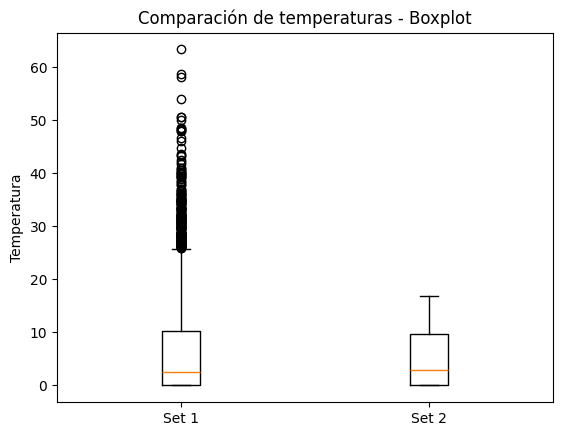

In [80]:
plt.boxplot([temp_1, temp_2], labels=['Set 1', 'Set 2'])
plt.ylabel('Temperatura')
plt.title('Comparación de temperaturas - Boxplot')
plt.show()


#### Plot KDE

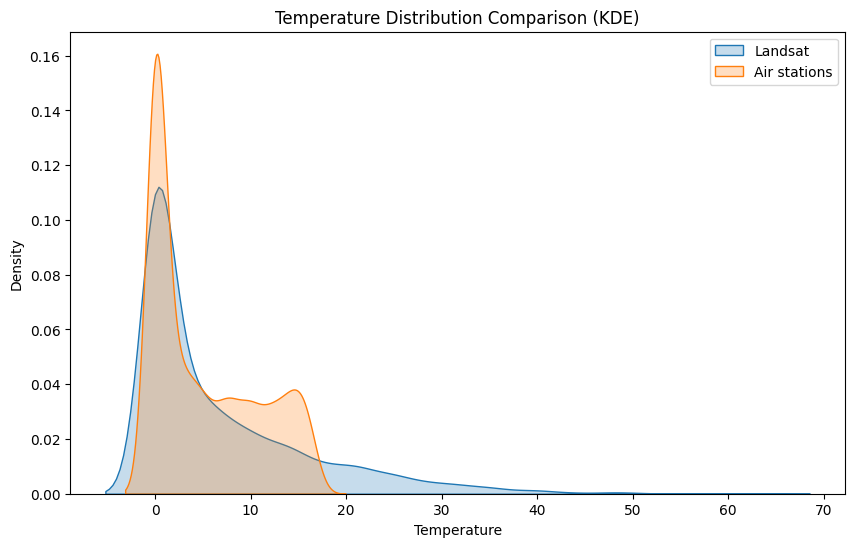

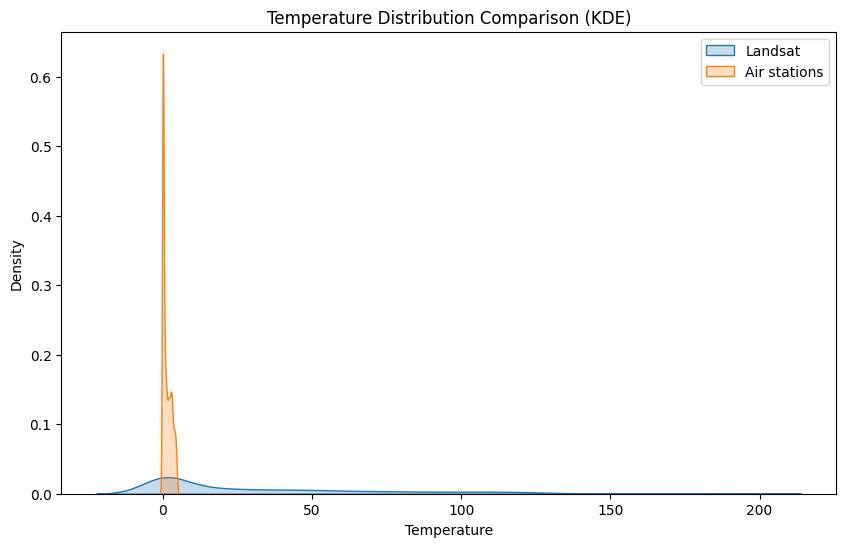

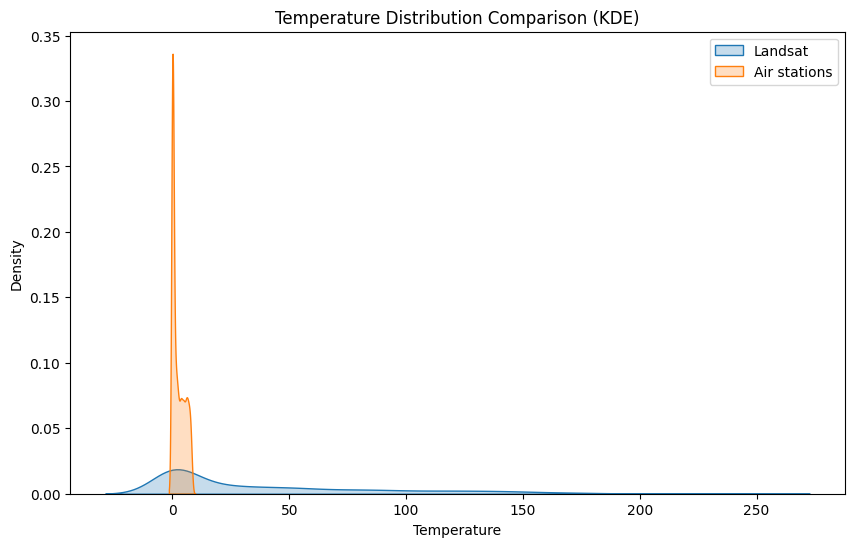

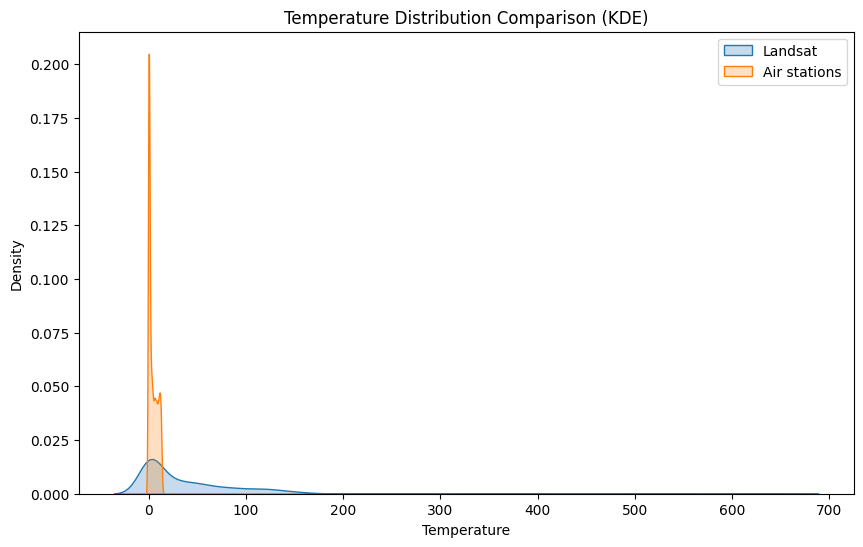

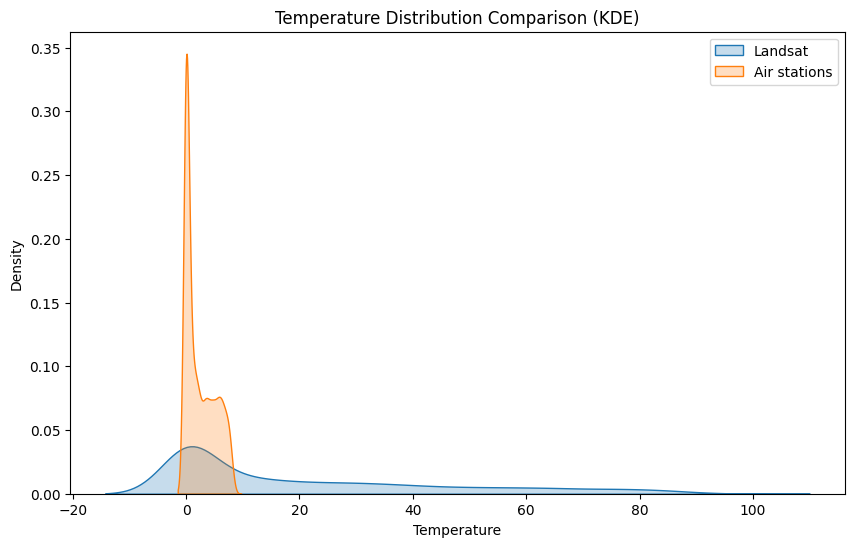

...

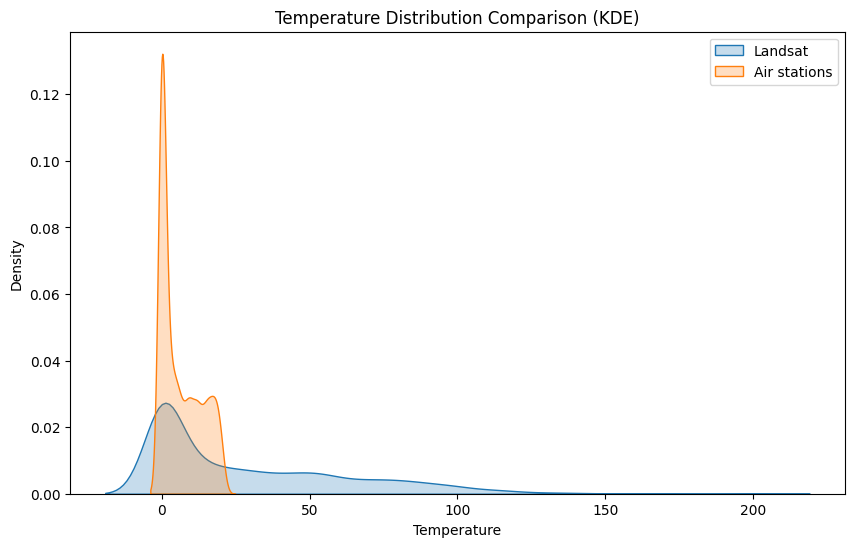

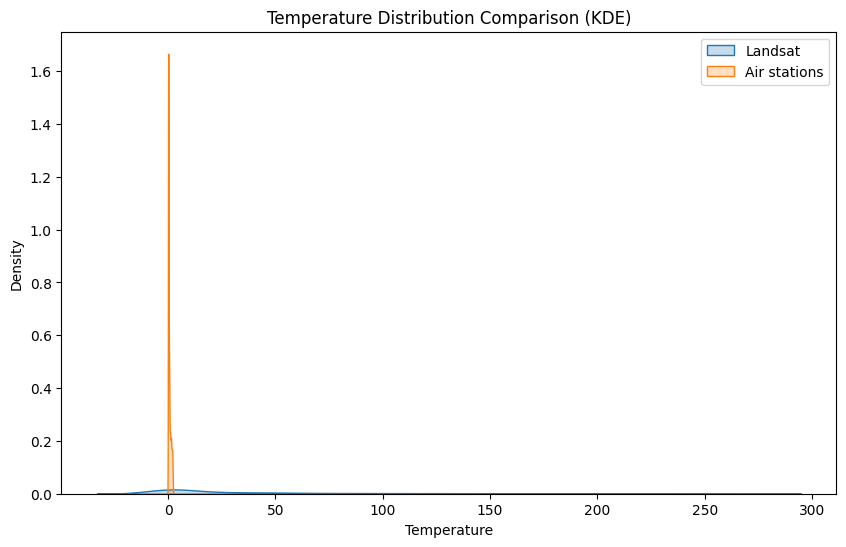

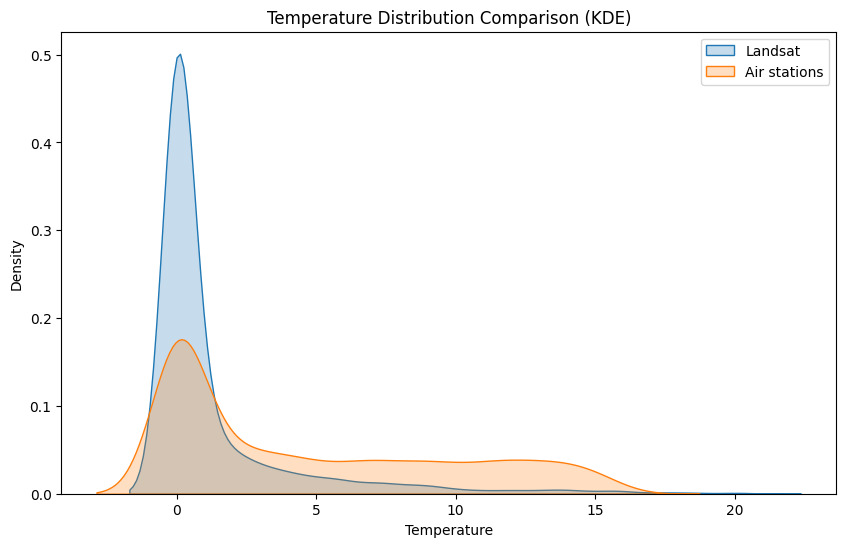

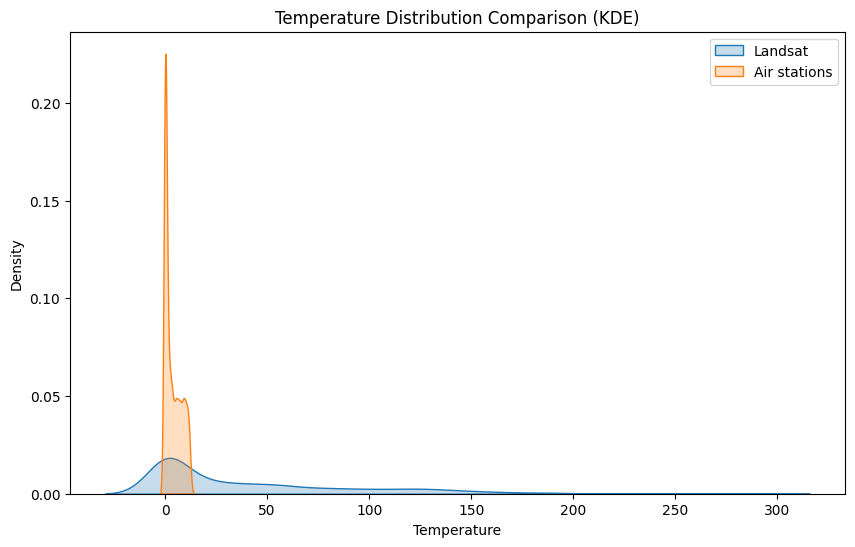

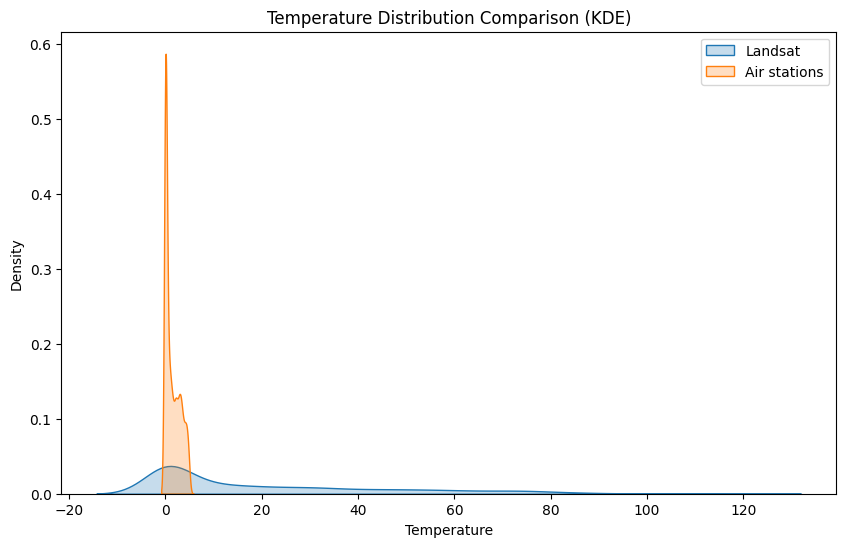

In [83]:
import seaborn as sns
p_values = {}
for i in range(filtered_lst.shape[0]):
  # Example temperature arrays
  temperature_array1 = filtered_lst[i]
  temperature_array2 = filtered_airtemp[i]

  # Plot KDE for both temperature arrays
  plt.figure(figsize=(10, 6))
  sns.kdeplot(temperature_array1, label='Landsat', fill=True)
  sns.kdeplot(temperature_array2, label='Air stations', fill=True)

  # Customize the plot
  plt.title('Temperature Distribution Comparison (KDE)')
  plt.xlabel('Temperature')
  plt.ylabel('Density')
  plt.legend(loc='upper right')
  plt.show()

  stat, p_value = ks_2samp(temperature_array1, temperature_array2)
  mse = mean_squared_error(temperature_array1, temperature_array2)
  rmse = np.sqrt(mse)


  p_values[i] = [p_value,rmse]


In [84]:
pd.DataFrame(p_values,index=['ks p_value', 'RMSE'])

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
ks p_value,3.851751e-34,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.231813e-318,0.00000,0.000000,1.413132e-280,0.000000,0.000000,1.106535e-224,0.000000,0.000000
RMSE,6.108918e+00,48.998924,61.810872,70.166529,29.305466,34.703398,94.480685,59.700468,28.869065,2.984840e+01,55.03612,29.565759,2.442104e+01,35.341396,74.713813,5.429611e+00,61.271802,30.766186


#### Pixel wise difference

Mean Squared Error: 6.733331785699782


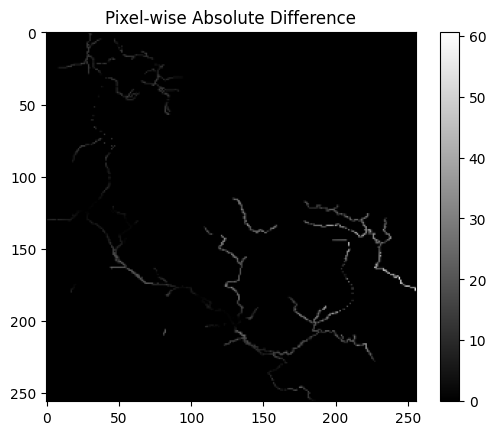

Mean Squared Error: 150.75635000030857


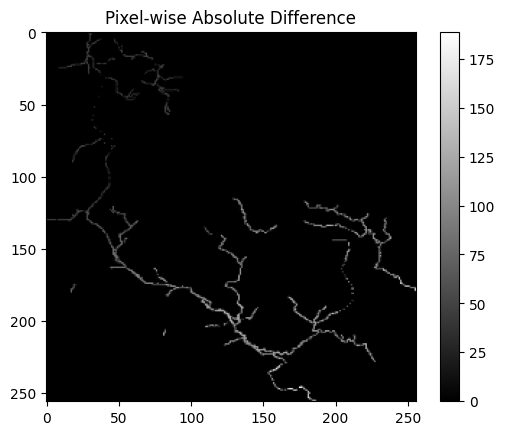

Mean Squared Error: 237.42063236042537


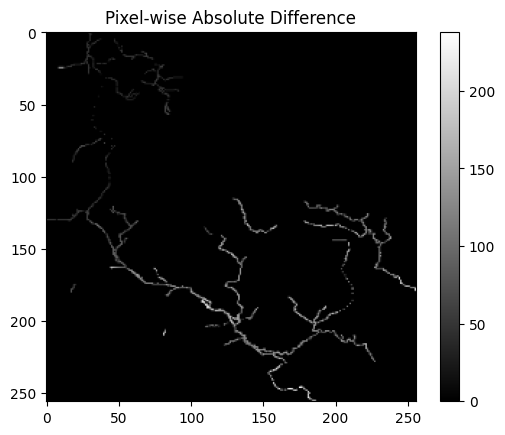

Mean Squared Error: 302.6138944369619


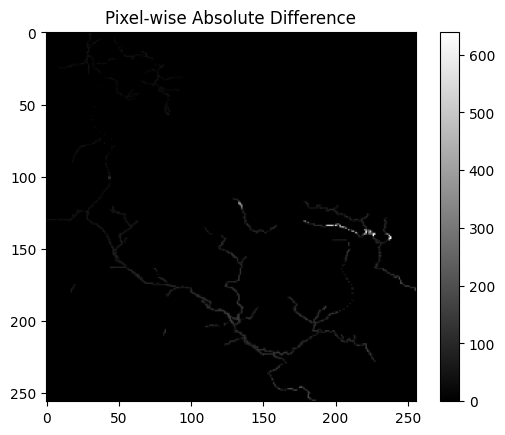

Mean Squared Error: 40.855617530431005


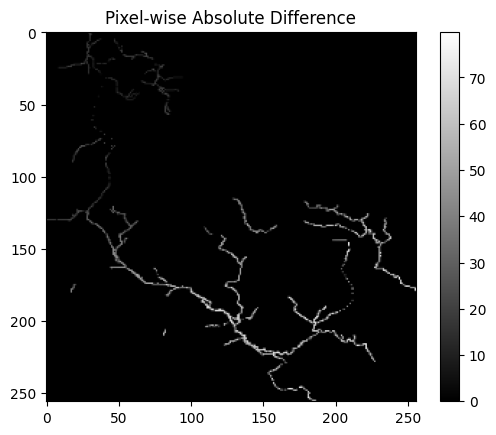

Mean Squared Error: 56.93202828405902


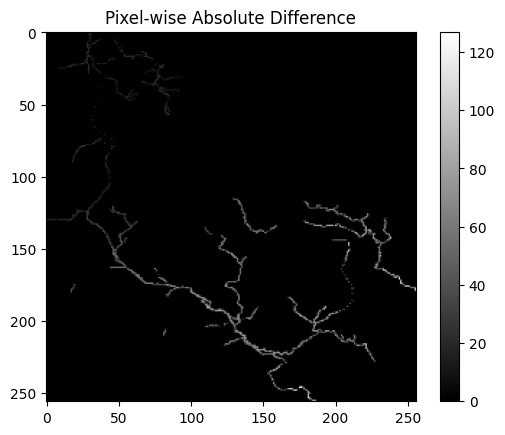

Mean Squared Error: 520.3913616712338


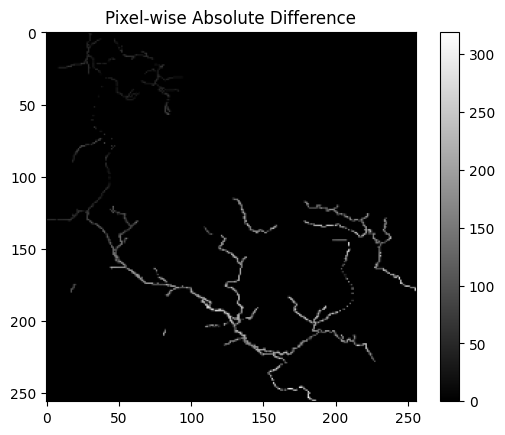

Mean Squared Error: 231.4280786812838


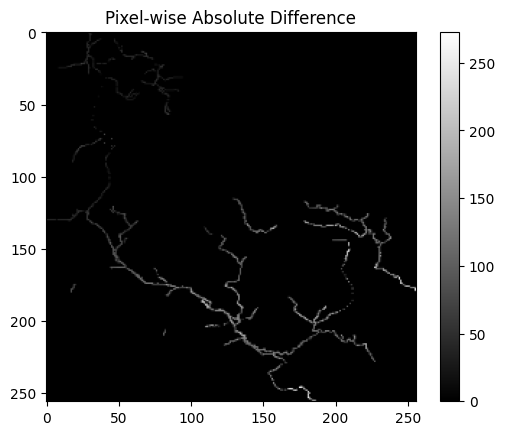

Mean Squared Error: 44.714326664288144


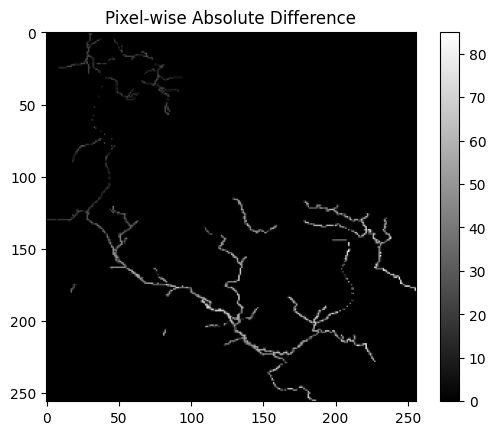

Mean Squared Error: 69.70859624887373


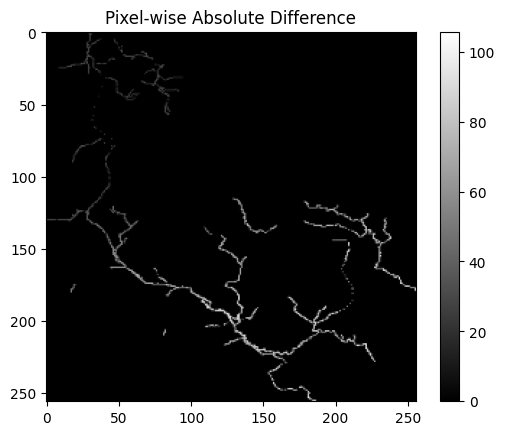

Mean Squared Error: 214.89220728362938


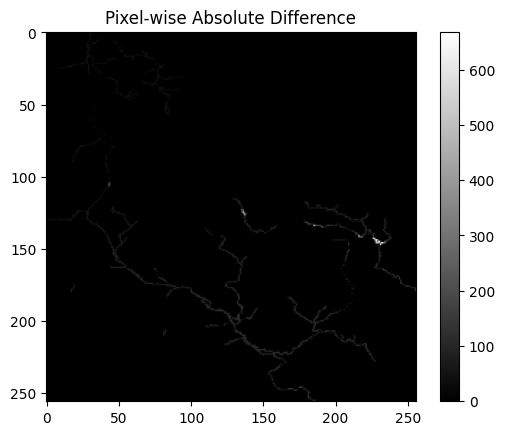

Mean Squared Error: 45.088402815266846


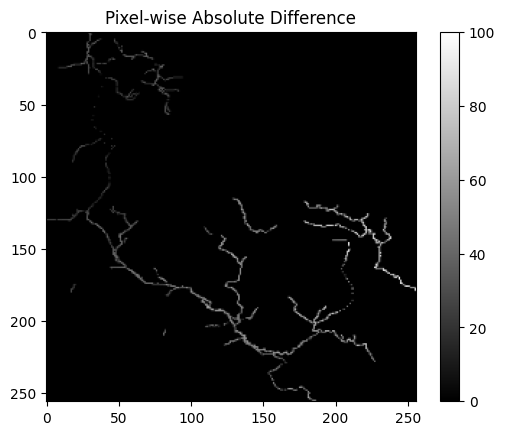

Mean Squared Error: 62.700762249980514


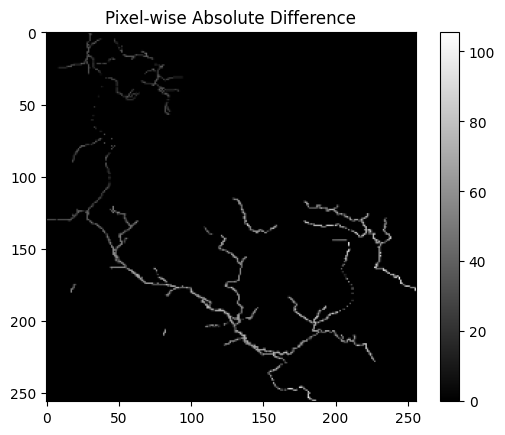

Mean Squared Error: 125.5799180921349


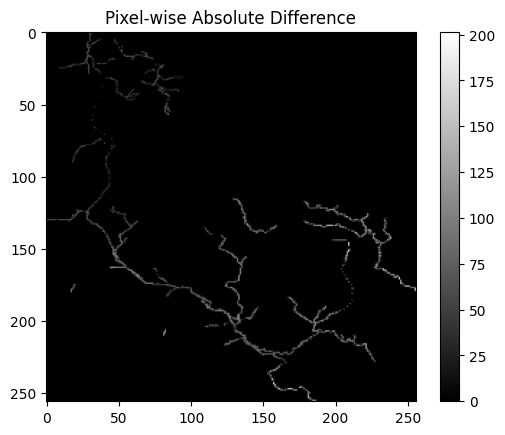

Mean Squared Error: 315.4947180834147


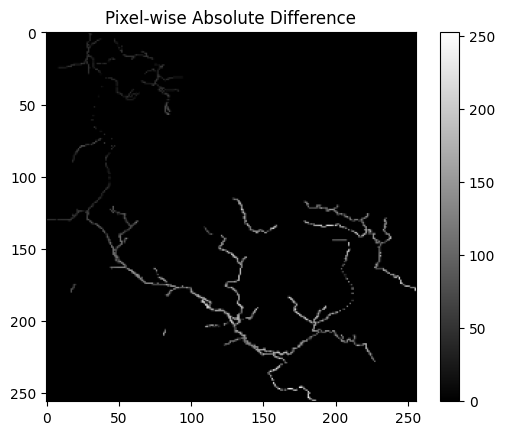

Mean Squared Error: 0.7131724439868378


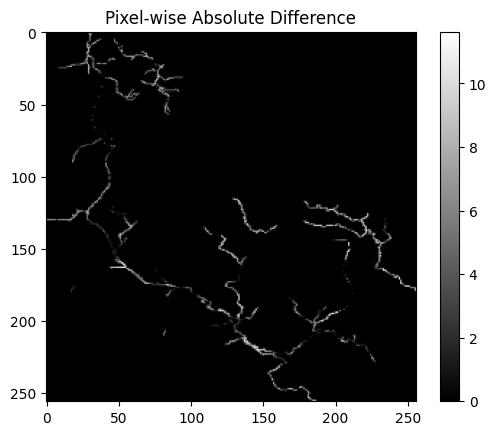

Mean Squared Error: 222.6432575049457


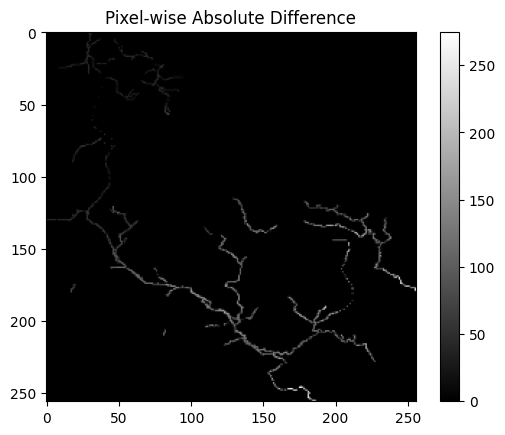

Mean Squared Error: 38.25658127062545


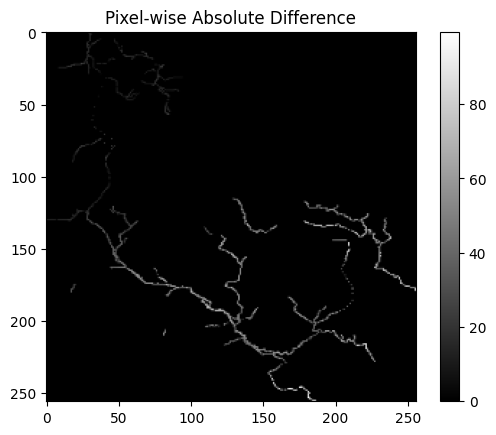

In [85]:
import cv2  # OpenCV for histogram calculation
import matplotlib.pyplot as plt

def mse(imageA, imageB):
    # Compute the Mean Squared Error between the two images
    return np.mean((imageA - imageB) ** 2)

for img_data, airtemp_dat in zip(masked_inputs, airtemp_data):
  img_gray = np.dot(img_data[...,:3], [0.2989, 0.5870, 0.1140]) # turn to gray image, calculate the weighted average of each channel contribution
  absolute_difference = np.abs(img_gray - airtemp_dat)

  img1 = img_gray
  img2 = airtemp_dat

  # Display the result
  mse_value = mse(img1, img2)
  print("Mean Squared Error:", mse_value)

  plt.imshow(absolute_difference, cmap='gray')
  plt.title("Pixel-wise Absolute Difference")
  plt.colorbar()
  plt.show()


In [86]:
mediana_lst = np.median(filtered_lst, axis=1)

mediana_air = np.median(filtered_airtemp, axis=1)
print(mediana_lst.shape,mediana_air.shape)

(18,) (18,)


In [87]:
plt.figure(figsize=(10,6))
# Plot df1
plt.plot(period_filt, mediana_lst, label='Temperature Landsat', marker='o')

# Plot df2
plt.plot(period_filt, mediana_air, label='Temperature interpolation', marker='o')

# Customize the plot
plt.title('Temperature Evolution Over Time')
plt.xlabel('Date')
plt.ylabel('Temperature')
plt.legend()
plt.grid(True)

# Show the plot
plt.show()

NameError: name 'period_filt' is not defined

<Figure size 1000x600 with 0 Axes>

## Correlation analysis

In [3]:
source_dir = '../data/preprocessed'
data = ['lst','wt','ndvi']
all_ds = {k: [] for k in data}
for d in data:
    source_path = os.path.join(source_dir,d)
    for subdir, dirs, files in os.walk(source_path):
        for file in files:
            if file.endswith('.csv'):
                all_ds[d].append(pd.read_csv(f'{subdir}/{file}',index_col=0))

In [17]:
from scipy.stats import pearsonr

for river in range(3):
    for i,row in all_ds['lst'][river].iterrows():
        corr_temp_ndvi, _ = pearsonr(all_ds['lst'][river].loc[i].values, all_ds['ndvi'][river].loc[i])
        corr_temp_water, _ = pearsonr(all_ds['lst'][river].loc[i], all_ds['wt'][river].loc[i])
        corr_ndvi_water, _ = pearsonr(all_ds['ndvi'][river].loc[i], all_ds['wt'][river].loc[i])

    print('River:', river)
    print("Correlation between LST and NDVI:", corr_temp_ndvi)
    print("Correlation between LST and water temperature:", corr_temp_water)
    print("Correlation between NDVI and water temperature:", corr_ndvi_water)

River: 0
Correlation between LST and NDVI: 0.09369590400203456
Correlation between LST and water temperature: 0.10318637820521265
Correlation between NDVI and water temperature: -0.19989918266097859
River: 1
Correlation between LST and NDVI: 0.6298770778048457
Correlation between LST and water temperature: -0.0008903574843250718
Correlation between NDVI and water temperature: 0.025075045232433705
River: 2
Correlation between LST and NDVI: 0.33339987965391177
Correlation between LST and water temperature: -0.0011519095433006974
Correlation between NDVI and water temperature: -0.14107705971153217
